# Performing a linear regression with given data 
Author: Syed Hasib Akhter Faruqui

Assume we have been provided a dataset where, we have to figure out how study time affects the grade of a student. Say, we want to fit the model using simple linear regression model. As we are given only one variable as input and corresponding output is given, this is a univariate problem. 

For fitting the model, we will approach the optimization procedure, as the optimized parameters for "slop" and "intercept" can be calculated with less effort (Shown Below). This step by step tutorial will serve as a demostration for both "linear regression" and "gradient descent optimization"  

### Solution Method 1
Say, you have the following linear regression model:

$y=mx + c$ 
where, $m$ = Slop and $c$ = Intercept.

Now, if we have our predictor values, $x$ and predicted values $y$ we can calculate the $m$ and $c$ by-

$m = \frac{N \sum{xy} - \sum{x}\sum{y}}{N\sum{x^2} - (\sum{x})^2}$ 

$c = \frac{\sum{y} - m \sum{x}}{N} $

By solving the above equations we can formulate the linear regression directly.

### Solution Method 2
We will be setting up a loss function to map the performance of the model into a real number. This will help us by measuring how well a model is performing a task. This is true for all the models we will be duscussing in this class in future. Loss functions plays an important role in guiding the learner to update its  parameters to a better performing one. 

For this case we will be utilizing one such measure "Squared Loss" which is also referred to as "Mean Squared Wrror". Say the estimated output parameter is $y'$. Then we can write the MSE error as:

$\mathcal{L}(y,y') = \frac{1}{M} \sum_{i=1}^M (y_i - y'_i)^2$

or it can be re-written as-

$\mathcal{L}(y,y') = \frac{1}{M} \sum_{i=1}^M ((m^Tx_i + c) - y'_i)^2$

We want to acheive the model with minimum MSE thus it will be considered as a minimization task. It is to be noted that, squared loss functions drive a model towards the mean of the training set thus, it is sensitive to outliers. 

Now, to update the model parameters we will be using the Gradient Descent method. It uses the gradient of the above mentioned equation (loss function) to update the model parameters. For convex functions convergence to global minimum is guranteed except for some special cases (we are not going to discuss these here). Now, taking the gradient of the above mentioned equation with respect to $m$ and $c$ we get,

$ \frac{\delta \mathcal{L}(y,x,m)}{\delta m} = - \frac{1}{M} \sum_{i=1}^M 2x_i ((m^Tx_i + c) - y'_i)$

$ \frac{\delta \mathcal{L}(y,x,m)}{\delta c} = - \frac{1}{M} \sum_{i=1}^M 2 ((m^Tx_i + c) - y'_i)$

Based on this the parameter update will be-

$m = m - \alpha \frac{\delta \mathcal{L}(y,x,m)}{\delta m}$

$c = c - \alpha \frac{\delta \mathcal{L}(y,x,m)}{\delta c}$

Where, $\alpha$ = Learning rate and $0 < \alpha < 1$

Based on the above discussion let's build the model!

In [1]:
# import necessary library
import numpy as np
import matplotlib.pyplot as plt

# inline plotting in jupyter notebook
%matplotlib inline

# Ignore all warnings
import warnings
warnings.filterwarnings("ignore")

In [2]:
# Read the dataset provided in Blackboard for Student Grades
Data = np.genfromtxt("StudentGrade_Univariate_Datasetss.csv", delimiter=",", skip_header = 1) # Doesn't read the header
# Check the Size of the data set
print('Number of Observations:', Data.shape[0])
print('Number of Variables:', Data.shape[1])
# Define the Predictor and target values
x = Data[:, 0][:, np.newaxis]            # Study Time
x /= np.max(x)                           # Normalize the Data
x = np.hstack((np.ones_like(x), x))      # To stack intercept column
y = Data[:, 1]                           # Student Grades

Number of Observations: 100
Number of Variables: 2


In [19]:
# Split the data into Train-Test
# We will first Randomize the data and then pick a portion of the data as Test data
Test_data_points = 30
Randomized_order = np.random.permutation(Data.shape[0]) #create random order of numbers (number of rows)

# Split the Data
x_train = x[Randomized_order[Test_data_points:]] # colon (:) used to get new random order
#print(x_train)
x_test  = x[Randomized_order[:Test_data_points]]
#print(x_test)
y_train = y[Randomized_order[Test_data_points:]]
y_test  = y[Randomized_order[:Test_data_points]]

In [20]:
# Gradient Descent Function
def Gradient_Descent_Function(m, x, y):
    y_predict = x.dot(m).flatten()
    
    Error     =  (y.flatten() - y_predict)
    MSE       =  (2.0/len(x)) * np.sum(np.power(Error, 2))
    Gradient  = -(2.0/len(x)) * Error.dot(x)
    return Gradient, MSE

In [21]:
def Plotting_Fitted_Model(x_train, x_test, y_train, y_test, m):
    # Plot the Fited Model
    #plt.figure(figsize=(14,8))
    plt.plot(x_train[:,1], x_train.dot(m), c='g', label='Model')
    plt.scatter(x_train[:,1], y_train, c='b', label='Train Data')
    plt.scatter(x_test[:,1], y_test, c='r', label='Test Data')
    plt.grid()
    plt.legend(loc='best')
    plt.xlabel('Study Hours (Normalized)')
    plt.ylabel('Study Grades')
    plt.show()

In [22]:
def Plot_Gradients(m, x_train, y_train):
    # Plot the Gradient Descent Contour
    m1 = np.linspace(-m[1]*3, m[1]*3, 300)
    m0 = np.linspace(-m[0]*3, m[0]*3, 300)
    J_vals = np.zeros(shape=(m1.size, m0.size))

    for i, el1 in enumerate(m1):
        for j, el2 in enumerate(m0):
            mT = [0, 0]
            mT[1] = el1
            mT[0] = el2
            J_vals[i, j] = Gradient_Descent_Function(mT, x_train, y_train)[1]

    # Set Figure Size
    plt.figure(figsize=(14,8))
    # Mark the optimized point
    plt.scatter(m[0], m[1], marker='*', color='r', s=40, label='Optimized Point')
    # Plot the contour Line
    CS = plt.contour(m0, m1, J_vals, np.logspace(-10,10,50), label='Gradient Descent Contour')
    plt.clabel(CS, inline=1, fontsize=10)
    plt.title("Contour Plot of Cost Function")
    plt.xlabel("Parameter 1")
    plt.ylabel("Parameter 2")
    plt.legend(loc='best')
    plt.show()

In [23]:
# Define a function to run the calculation
def Calculate_Parameters(alpha, t, x_train, y_train, x_test, y_test, 
                         RUN_OPTIMIZATION = True, Print_Updates= True, Plot_Fitted_Model = False, Plot_Gradient= False):
    m     = np.random.randn(2)  # Random initialization of the parameters
                                # Here, m has two parameters for both intercept and slope
    count = 1                   # Count Number of Iterations it took to minimize the loss function
    StuckCheck = 0              # To check if its stuck in a search repetation
    while RUN_OPTIMIZATION:
        # Calculate the Gradient
        Grad, MSE = Gradient_Descent_Function(m, x_train, y_train)
        # Update the parameters
        m_updated = m - (alpha * Grad)
        
        # Checking with a threshold if it's stuck in loop
        StuckCheck += 1
        if StuckCheck > 10_000:
            print('Stopping the Optimization as it\'s Stuck in a search loop')
            break
            
        # Stop updating the gradient if it reaches certain toleranec limit
        if np.sum(abs(m_updated - m)) < t:
            RUN_OPTIMIZATION = False        #ends the while loop
            print('Optimization Operation Complete!!')
        
        # Print Updates
        if Print_Updates:
            # print the MSE Errors every 100 iterations to check how the error is reduced
            if count % 100 == 0:
                print('Iteration: %d and Error:%f \n' % (count, MSE))

        count += 1
        m = m_updated
        
        # Plot the fitted Model
        if Plot_Fitted_Model:
            if count % 50 == 0:
                Plotting_Fitted_Model(x_train, x_test, y_train, y_test, m)
            
    # Plot Gradient
    if Plot_Gradient:
        Plot_Gradients(m, x_train, y_train)
            
    print('Optimization operation took %d iterations' % count)
    return m, count

In [24]:
# Select initial Hyper parameters
alpha = .6                 # Learning Rate
t     = 1e-6                # Tolerance

[1.77796818 1.84437581 1.81094337 1.76928155 1.81611573 1.80081054
 1.79771344 1.72794546 1.80506243 1.80319187 1.76978548 1.79233575
 1.8336739  1.74457831 1.79479001 1.78344399 1.75833327 1.8216763
 1.81204071 1.79342049 1.81850138 1.79811113 1.8403066  1.78024676
 1.778307   1.81300969 1.78993699 1.7747822  1.76509963 1.75043901
 1.80141339 1.80522746 1.75482563 1.79246682 1.76110234 1.80777197
 1.81725483 1.74736158 1.79768203 1.82415937 1.78722298 1.7570611
 1.83915724 1.83168154 1.77708276 1.79673805 1.82545398 1.76354663
 1.79208879 1.78929842 1.78070538 1.7516464  1.78710758 1.81842899
 1.80967356 1.82985616 1.81131024 1.81131002 1.78548694 1.79271516
 1.78228204 1.7498738  1.79217523 1.80301342 1.80930872 1.79479023
 1.81080935 1.76139674 1.76778173 1.77251165]
[130.77623821 154.60806436 142.6101045  127.65885132 144.4663196
 138.97371639 137.86225495 112.82449538 140.49960192 139.82831153
 127.83969863 135.932355   150.76744987 118.79355494 136.81311786
 132.74135362 123.7298

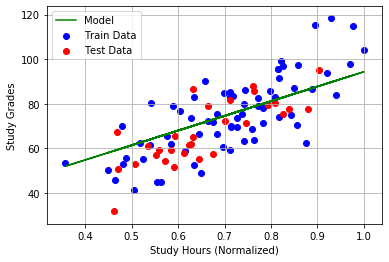

[70.12917659 94.30425259 82.13348609 66.96688997 84.01643626 78.44472307
 77.31725325 51.91887477 79.99258593 79.31162695 67.15034203 75.35955695
 90.40832172 57.97390671 76.25300544 72.12259556 62.98127158 86.04070929
 82.53296459 75.75444498 84.88490927 77.46202937 92.82289625 70.95867165
 70.25252241 82.88571007 74.48630983 68.969351   65.44450185 60.10744082
 78.66418663 80.05266399 61.70434961 75.40727256 63.98932436 80.97896827
 84.43111319 58.9871294  77.30581797 86.94464709 73.49830048 62.51815047
 92.40448149 89.68302178 69.80684812 76.96217086 87.41593848 64.87914701
 75.26965471 74.25384432 71.12562854 60.54698029 73.45629041 84.85855764
 81.67122327 89.01851162 82.26704292 82.26696261 72.86631108 75.49767845
 71.69959831 59.90168084 75.30112176 79.24666178 81.53840561 76.25308532
 82.08469748 64.09649892 66.42089585 68.14277739]
[70.08674271 94.41038996 82.16482634 66.90502182 84.05934844 78.45339352
 77.31899469 51.76452698 80.01076899 79.32562508 67.08960131 75.34926709
 

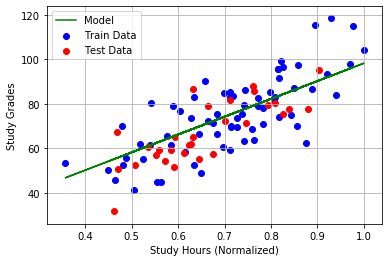

[68.87265194 98.24872062 83.45955212 65.03003531 85.7475976  78.97719368
 77.60716155 46.74461076 80.85806163 80.03060207 65.25295499 75.22828915
 93.51462453 54.10231397 76.31395292 71.29493233 60.18695644 88.20736995
 83.94497387 75.70813285 86.80291271 77.7830846  96.44866731 69.88060342
 69.0225342  84.37360853 74.16717284 67.46330305 63.1801227  56.69485367
 79.24387233 80.93106481 58.63531924 75.28627024 61.41188032 82.05665291
 86.25148755 55.33352    77.59326609 89.3057797  72.96660451 59.6242001
 95.94023537 92.63328456 68.48097816 77.17568722 89.87846406 62.49313819
 75.11904547 73.88469503 70.08347919 57.22895506 72.91555646 86.77089182
 82.8978387  91.82581259 83.62184218 83.62174459 72.19864979 75.39612593
 70.78093203 56.44482678 75.15728229 79.95166039 82.73644684 76.31404999
 83.40026719 61.54211227 64.36657677 66.45890153]
Iteration: 100 and Error:252.985986 

[68.8563928  98.29995645 83.47680809 65.00494731 85.77011063 78.98415091
 77.61097098 46.67750986 80.86934038 

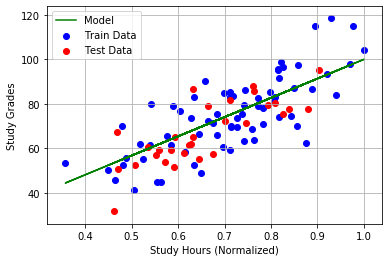

[ 68.30780707 100.02869939  84.05904645  64.1584694   86.52972573
  79.21890222  77.73951292  44.41348619  81.24990271  80.35639459
  64.39918273  75.17075683  94.91672358  52.35848774  76.34307924
  70.92343601  58.92881172  89.18583928  84.58321499  75.68890208
  87.66927702  77.9294783   98.08496423  69.39621413  68.46965307
  85.04606365  74.02494128  66.78596272  62.16089514  55.15796624
  79.50686739  81.32873306  57.25332147  75.23336602  60.2515101
  82.54416659  87.07383662  53.68796971  77.72450831  90.37192505
  72.72854254  58.32113567  97.53594882  93.96503428  67.88486954
  77.27359793  90.99032159  61.41907493  75.05279322  73.71991584
  69.61528362  55.73470007  72.67341979  87.6347002   83.45249657
  93.09310919  84.23429065  84.23418527  71.89928899  75.35199049
  70.36840776  54.88798198  75.09408214  80.27115172  83.27822227
  76.34318406  83.99502935  60.39213728  63.44205302  65.70138898]
[ 68.30047779 100.05179594  84.06682533  64.14716019  86.53987442
  79.22203

[ 68.16046566 100.49301211  84.21542634  63.93111892  86.73374618
  79.28195264  77.7740372   43.80540554  81.35211564  80.44137856
  64.17647377  75.15574939  95.28246527  51.90360558  76.35067697
  70.82653015  58.60062102  89.44107591  84.7497021   75.68388571
  87.89527073  77.96766557  98.51179713  69.2698598   68.32543244
  85.22147558  73.9878398   66.60927654  61.89502668  54.75706468
  79.57547046  81.43246603  56.89282334  75.21956584  59.94882416
  82.67133601  87.28834883  53.25872313  77.75874327  90.65003224
  72.66644341  57.98122753  97.95219539  94.31242514  67.7293729
  77.29913827  91.28035292  61.13890241  75.03551117  73.67693275
  69.49315347  55.34491931  72.61025776  87.86002719  83.59718074
  93.42368726  84.39404967  84.39394225  71.82119989  75.34047767
  70.26079963  54.48187449  75.07759624  80.354492    83.41954602
  76.3507838   84.15017484  60.09216297  63.20088832  65.50378965]
[ 68.1554657  100.50876837  84.22073303  63.92340387  86.74066953
  79.28409

  76.35614422  84.2596053   59.88057882  63.030785    65.36441476]


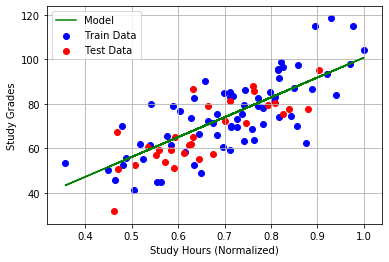

[ 68.05318274 100.83108971  84.32929042  63.7655794   86.88229853
  79.32786121  77.79917519  43.36264696  81.42653941  80.5032575
  64.01431386  75.14482211  95.54877086  51.57239462  76.35620906
  70.75597058  58.36165724  89.62692003  84.87092549  75.68023318
  88.05982235  77.99547066  98.82258473  69.17785808  68.22042183
  85.34919735  73.9608253   66.48062696  61.70144127  54.46515832
  79.62542206  81.50799657  56.63033572  75.20951758  59.72843103
  82.76393121  87.44454048  52.94617806  77.78367059  90.85252897
  72.6212275   57.73373199  98.25527483  94.56536903  67.61615194
  77.31773482  91.49153192  60.93490186  75.02292768  73.64563569
  69.40422748  55.06111028  72.56426793  88.02409335  83.70252887
  93.66438935  84.51037417  84.51026527  71.76434128  75.3320949
  70.18244748  54.18617756  75.06559244  80.41517413  83.52244734
  76.35631737  84.26314012  59.87374424  63.02529033  65.35991268]
Iteration: 200 and Error:247.776198 

[ 68.0498788  100.84150132  84.33279703

[ 67.98676324 101.04039557  84.39978435  63.66309289  86.97426818
  79.35628348  77.81473826  43.08853246  81.47261561  80.54156712
  63.91391968  75.13805696  95.71364224  51.36733993  76.35963401
  70.71228674  58.21371333  89.74197724  84.94597561  75.67797187
  88.16169725  78.01268496  99.0149952   69.12089926  68.15540913
  85.42827066  73.94410045  66.40097923  61.58159138  54.28443735
  79.65634739  81.55475798  56.46782805  75.20329665  59.59198433
  82.82125745  87.54123967  52.75267953  77.79910324  90.97789591
  72.59323406  57.58050602  98.44291313  94.72196811  67.54605617
  77.32924805  91.62227411  60.8086039   75.01513716  73.6262595
  69.34917287  54.88540241  72.53579535  88.1256677   83.76775053
  93.81340946  84.58239136  84.58228155  71.72913977  75.32690508
  70.1339392   54.00310982  75.05816082  80.4527428   83.58615417
  76.35974323  84.3330776   59.73851989  62.91657656  65.27083759]
[ 67.98450932 101.04749828  84.40217653  63.65961505  86.97738914
  79.35724

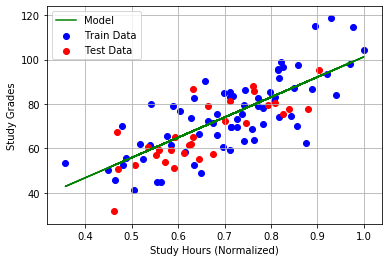

[ 67.93840155 101.19279636  84.45111272  63.58846992  87.04123356
  79.37697844  77.82607013  42.88894291  81.50616483  80.5694613
  63.8408202   75.13313109  95.83368918  51.21803452  76.3621278
  70.68047944  58.1059917   89.82575324  85.00062147  75.67632535
  88.23587488  78.02521912  99.15509403  69.07942614  68.10807177
  85.4858459   73.93192268  66.34298575  61.4943257   54.15284993
  79.67886489  81.58880613  56.3495022   75.19876703  59.4926341
  82.86299811  87.61164875  52.61178846  77.81034014  91.06917868
  72.57285134  57.4689384   98.57953722  94.83599178  67.4950177
  77.33763113  91.71747074  60.71664322  75.00946469  73.61215121
  69.30908624  54.75746516  72.51506375  88.19962649  83.81524004
  93.92191469  84.63482886  84.63471839  71.70350868  75.32312624
  70.09861912  53.86981366  75.05274967  80.48009748  83.63254069
  76.36223768  84.38400081  59.6400597   62.83741938  65.2059798 ]
[ 67.93691218 101.19748977  84.45269346  63.58617179  87.04329586
  79.37761577

  76.3644868   84.42991564  59.55128323  62.76604743  65.14750089]
[ 67.8939963  101.33272935  84.49824197  63.5199518   87.10272056
  79.39598036  77.83647494  42.70568163  81.53696942  80.59507349
  63.77370093  75.1286082   95.94391517  51.08094369  76.36441758
  70.65127428  58.0070827   89.90267559  85.05079679  75.67481354
  88.3039841   78.03672787  99.28373148  69.0413459   68.06460705
  85.53871095  73.92074116  66.28973667  61.41419917  54.03202758
  79.69954025  81.62006882  56.2408565   75.19460798  59.40141164
  82.90132399  87.67629771  52.48242359  77.82065776  91.15299368
  72.55413612  57.36649804  98.7049842   94.94068726  67.44815465
  77.34532838  91.80487939  60.63220578  75.00425629  73.59919711
  69.27227907  54.63999436  72.4960282   88.26753478  83.85884446
  94.02154318  84.68297649  84.68286541  71.67997445  75.31965654
  70.06618854  53.74742236  75.0477812   80.5052143   83.67513236
  76.36452807  84.43075803  59.54965446  62.76473798  65.14642799]
[ 67.893

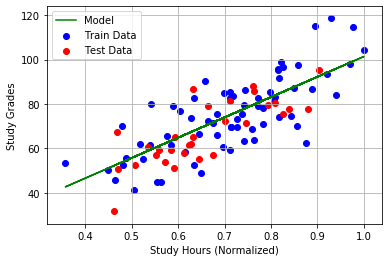

[ 67.88665975 101.35584881  84.50602857  63.50863137  87.11287932
  79.39911982  77.838194    42.67540356  81.54205889  80.59930508
  63.76261161  75.12786093  95.96212649  51.05829381  76.36479589
  70.64644906  57.99074115  89.91538455  85.05908666  75.67456376
  88.31523697  78.03862932  99.3049847   69.03505436  68.05742589
  85.54744521  73.91889378  66.28093896  61.40096082  54.01206555
  79.7029562   81.62523398  56.22290627  75.19392083  59.38634004
  82.90765612  87.68697888  52.46105017  77.82236241  91.16684143
  72.55104403  57.34957304  98.72571031  94.95798484  67.44041203
  77.34660011  91.81932088  60.61825519  75.00339577  73.59705686
  69.26619786  54.62058606  72.49288318  88.27875445  83.8660487
  94.03800361  84.69093135  84.69082016  71.67608617  75.31908329
  70.06083043  53.72720111  75.04696032  80.50936405  83.68216927
  76.36490648  84.43848317  59.53471788  62.7527297   65.13658895]
Iteration: 300 and Error:247.561067 

[ 67.88598836 101.35796453  84.5067411

  76.36604455  84.46171632  59.4897965   62.7166151   65.1069983 ]
[ 67.86427269 101.4263965   84.52978893  63.47408773  87.14387819
  79.40869971  77.84343962  42.58301176  81.55758913  80.61221755
  63.7287732   75.1255807   96.0176973   50.98917899  76.36595029
  70.63172518  57.94087584  89.95416521  85.08438272  75.67380157
  88.34957446  78.0444315   99.36983771  69.01585607  68.03551301
  85.57409731  73.91325657  66.25409325  61.36056475  53.95115254
  79.71337975  81.64099517  56.16813216  75.19182403  59.34034993
  82.92697825  87.71957188  52.39583043  77.82756407  91.20909705
  72.54160868  57.29792738  98.78895483  95.01076743  67.41678586
  77.35048071  91.86338826  60.57568576  75.00076993  73.59052601
  69.2476414   54.56136275  72.48328634  88.31299064  83.88803202
  94.08823166  84.71520514  84.71509365  71.66422131  75.31733403
  70.04448044  53.66549712  75.04445545  80.52202677  83.70364201
  76.36606119  84.46205598  59.48913977  62.71608713  65.1065657 ]
[ 67.863

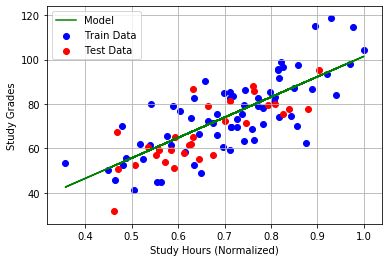

[ 67.86333525 101.42935063  84.53078388  63.47264124  87.14517625
  79.40910086  77.84365928  42.57914292  81.55823944  80.61275825
  63.72735624  75.12548522  96.02002429  50.98628486  76.36599863
  70.63110863  57.93878777  89.95578912  85.08544197  75.67376965
  88.35101232  78.04467446  99.37255338  69.01505216  68.03459542
  85.57521335  73.91302052  66.25296911  61.3588732   53.94860186
  79.71381623  81.64165516  56.16583854  75.19173623  59.33842413
  82.92778735  87.72093668  52.3930994   77.82778189  91.21086647
  72.54121358  57.29576476  98.79160315  95.01297766  67.41579653
  77.35064321  91.86523354  60.5739032   75.00065997  73.59025253
  69.24686436  54.55888282  72.48288448  88.31442426  83.88895255
  94.09033492  84.71622159  84.71611008  71.66372448  75.31726078
  70.0437958   53.66291331  75.04435056  80.52255702  83.70454116
  76.36610954  84.46304307  59.48723122  62.71455275  65.1053085 ]
[ 67.8630326  101.43030437  84.5311051   63.47217424  87.14559533
  79.4092

  76.36651336  84.47128695  59.47129166  62.70173812  65.09480878]
[ 67.85532717 101.45458626  84.53928321  63.46028463  87.15626486
  79.41252768  77.84553569  42.54609344  81.56379477  80.61737717
  63.7152519   75.12466956  96.03990253  50.9615618   76.36641157
  70.62584175  57.92095044  89.96966136  85.09449062  75.67349701
  88.36329519  78.04674995  99.39575196  69.00818474  68.02675696
  85.58474707  73.91100404  66.24336613  61.34442312  53.92681266
  79.71754484  81.64729309  56.14624529  75.19098618  59.321973
  82.93469907  87.73259552  52.36976964  77.82964258  91.22598173
  72.53783847  57.27729059  98.81422635  95.03185852  67.40734522
  77.35203134  91.88099689  60.55867569  74.99972069  73.58791638
  69.24022653  54.53769805  72.47945159  88.32667089  83.89681621
  94.108302    84.72490457  84.72479295  71.6594803   75.31663505
  70.03794725  53.64084117  75.04345455  80.5270866   83.71222218
  76.36652259  84.47147531  59.47092747  62.70144533  65.09456888]
[ 67.85515

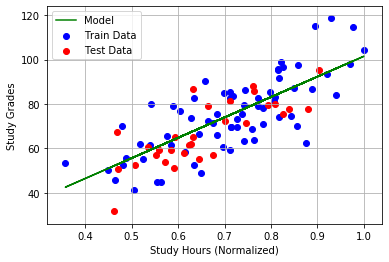

[ 67.85282088 101.46248426  84.54194324  63.45641738  87.15973527
  79.41360017  77.84612295  42.53574993  81.56553342  80.61882276
  63.7114636   75.12441428  96.04612383  50.95382421  76.36654081
  70.62419337  57.91536789  89.97400296  85.09732258  75.67341168
  88.36713936  78.04739952  99.40301243  69.00603544  68.02430375
  85.58773084  73.91037294  66.24036068  61.33990067  53.91999329
  79.71871178  81.6490576   56.14011318  75.19075144  59.31682428
  82.93686223  87.7362444   52.36246812  77.83022491  91.23071236
  72.53678215  57.27150872  98.82130674  95.03776767  67.4047002
  77.35246578  91.88593035  60.55390993  74.99942672  73.58718523
  69.23814908  54.53106784  72.4783772   88.33050372  83.8992773
  94.11392516  84.72762209  84.72751043  71.65815199  75.31643922
  70.03611682  53.63393325  75.04317412  80.52850423  83.71462611
  76.36665186  84.47411434  59.46582488  62.69734309  65.0912077 ]
Iteration: 400 and Error:247.552184 

[ 67.85268445 101.46291419  84.54208804

[ 67.84847147 101.47619044  84.54655947  63.44970615  87.16575781
  79.41546138  77.84714208  42.51779982  81.56855067  80.62133142
  63.70488939  75.12397127  96.05692027  50.94039641  76.36676508
  70.62133278  57.90567993  89.98153736  85.10223717  75.6732636
  88.37381054  78.04852678  99.41561223  69.00230555  68.02004646
  85.59290888  73.90927773  66.23514503  61.33205242  53.90815896
  79.7207369   81.65211972  56.12947153  75.19034407  59.30788921
  82.94061618  87.74257665  52.34979706  77.83123551  91.23892189
  72.53494903  57.26147487  98.83359405  95.0480224   67.40011005
  77.35321971  91.89449187  60.54563943  74.99891656  73.5859164
  69.23454389  54.51956179  72.4765127   88.33715522  83.90354828
  94.12368359  84.73233806  84.73222634  71.65584686  75.31609937
  70.03294031  53.62194524  75.04268747  80.53096437  83.71879788
  76.3668762   84.47869413  59.45696985  62.69022408  65.08537471]
[ 67.8484038  101.4764037   84.54663129  63.44960173  87.16585151
  79.415490

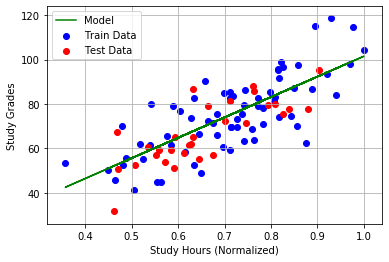

[ 67.84808115 101.47742045  84.54697373  63.44910388  87.16629827
  79.4156284   77.84723354  42.51618896  81.56882144  80.62155655
  63.70429942  75.12393152  96.05788915  50.93919139  76.36678521
  70.62107607  57.90481053  89.98221351  85.10267821  75.67325032
  88.37440921  78.04862794  99.41674295  69.00197083  68.01966441
  85.59337356  73.90917944  66.23467698  61.33134812  53.90709694
  79.72091863  81.65239452  56.12851654  75.19030751  59.30708737
  82.94095306  87.74314491  52.34865995  77.8313262   91.23965862
  72.53478453  57.26057442  98.83469672  95.04894267  67.39969813
  77.35328737  91.89526019  60.54489723  74.99887078  73.58580254
  69.23422036  54.51852923  72.47634538  88.33775213  83.90393156
  94.12455932  84.73276128  84.73264955  71.65563999  75.31606887
  70.03265524  53.62086943  75.0426438   80.53118515  83.71917226
  76.36689633  84.47910512  59.4561752   62.68958522  65.08485125]
[ 67.84801965 101.47761425  84.547039    63.44900898  87.16638343
  79.4156

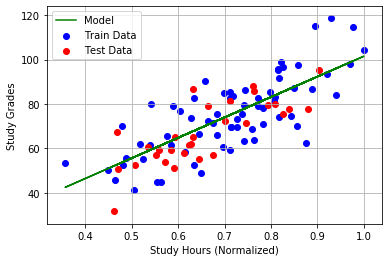

[ 67.84594454 101.48415348  84.54924141  63.44580706  87.16925679
  79.4165427   77.84773418  42.50737115  81.57030364  80.62278891
  63.7010699   75.12371389  96.06319279  50.93259511  76.36689539
  70.61967083  57.90005141  89.98591471  85.10509245  75.67317757
  88.37768636  78.0491817   99.42293248  69.00013855  68.01757306
  85.59591722  73.90864143  66.23211484  61.32749274  53.90128344
  79.72191345  81.65389876  56.12328894  75.19010739  59.3026981
  82.94279716  87.74625556  52.34243541  77.83182264  91.24369147
  72.53388402  57.25564539  98.84073274  95.05398021  67.39744326
  77.35365773  91.89946595  60.54083443  74.99862017  73.58517924
  69.23244934  54.51287699  72.47542947  88.34101961  83.90602963
  94.12935306  84.73507795  84.7349662   71.65450762  75.31590192
  70.03109481  53.61498043  75.04240473  80.53239367  83.72122161
  76.36700654  84.4813549   59.45182525  62.68608807  65.08198585]
Iteration: 500 and Error:247.551817 

[ 67.84591682 101.48424084  84.5492708

[ 67.84507468 101.48689466  84.55016463  63.44446484  87.17046127
  79.41691493  77.847938    42.5037812   81.57090708  80.62329063
  63.69975508  75.12362529  96.06535203  50.9299096   76.36694024
  70.61909872  57.89811386  89.98742156  85.10607534  75.67314796
  88.37902057  78.04940715  99.42545239  68.99939259  68.01672161
  85.59695281  73.90842239  66.23107173  61.32592312  53.89891662
  79.72231846  81.65451117  56.12116065  75.19002592  59.30091112
  82.94354793  87.74752199  52.33990125  77.83202476  91.24533334
  72.53351741  57.25363866  98.84319015  95.05603111  67.39652525
  77.35380852  91.90117822  60.53918037  74.99851814  73.58492548
  69.23172831  54.51057583  72.47505657  88.34234988  83.90688381
  94.1313047   84.73602113  84.73590936  71.6540466   75.31583395
  70.03045952  53.61258288  75.0423074   80.53288569  83.72205595
  76.36705141  84.48227084  59.45005428  62.6846643   65.08081927]
[ 67.8450607  101.48693869  84.55017946  63.44444328  87.17048062
  79.4169

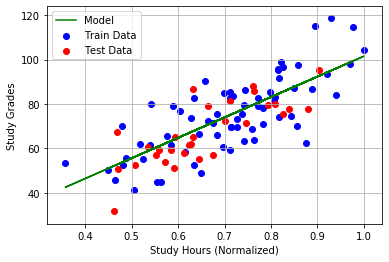

[ 67.84498139 101.48718864  84.55026364  63.44432089  87.17059045
  79.41695485  77.84795986  42.50339619  81.57097179  80.62334444
  63.69961408  75.12361579  96.0655836   50.9296216   76.36694505
  70.61903737  57.89790607  89.98758316  85.10618075  75.67314478
  88.37916366  78.04943133  99.42572264  68.99931259  68.0166303
  85.59706387  73.9083989   66.23095986  61.32575479  53.89866279
  79.7223619   81.65457685  56.1209324   75.19001718  59.30071947
  82.94362845  87.74765781  52.33962948  77.83204643  91.24550942
  72.53347809  57.25342345  98.8434537   95.05625106  67.3964268
  77.35382469  91.90136185  60.53900298  74.9985072   73.58489826
  69.23165099  54.51032904  72.47501658  88.34249254  83.90697541
  94.13151401  84.73612228  84.73601051  71.65399716  75.31582666
  70.03039139  53.61232576  75.04229697  80.53293846  83.72214542
  76.36705622  84.48236907  59.44986435  62.68451161  65.08069416]
[ 67.84496889 101.48722802  84.55027691  63.44430161  87.17060775
  79.416960

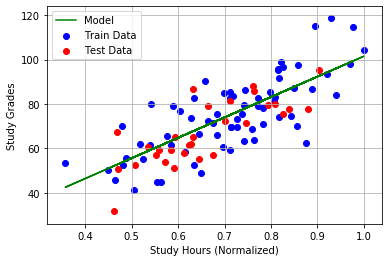

[ 67.84454721 101.48855684  84.55072445  63.44365095  87.17119164
  79.41714065  77.84806159  42.50160434  81.57127299  80.62359487
  63.69895781  75.12357157  96.06666135  50.92828118  76.36696744
  70.61875181  57.89693897  89.98833528  85.10667135  75.67313
  88.3798296   78.04954385  99.4269804   68.99894026  68.01620532
  85.59758076  73.90828958  66.23043921  61.32497134  53.89748144
  79.72256406  81.65488253  56.11987011  75.18997652  59.29982754
  82.94400318  87.74828992  52.3383646   77.83214731  91.24632893
  72.5332951   57.25242183  98.84468027  95.05727473  67.39596859
  77.35389995  91.9022165   60.53817738  74.99845628  73.5847716
  69.2312911   54.50918046  72.47483046  88.34315652  83.90740176
  94.13248813  84.73659305  84.73648128  71.65376705  75.31579274
  70.0300743   53.61112906  75.04224839  80.53318404  83.72256187
  76.36707861  84.48282624  59.4489804   62.68380096  65.08011189]
Iteration: 600 and Error:247.551802 

[ 67.84454158 101.4885746   84.55073043  

  76.36708613  84.4829797   59.4486837   62.68356242  65.07991644]
[ 67.84439814 101.48902659  84.55088266  63.44342094  87.17139805
  79.41720444  77.84809652  42.50098913  81.5713764   80.62368085
  63.69873249  75.12355638  96.06703137  50.92782097  76.36697513
  70.61865377  57.89660694  89.9885935   85.10683978  75.67312492
  88.38005825  78.04958249  99.42741224  68.99881242  68.01605941
  85.59775823  73.90825204  66.23026046  61.32470236  53.89707584
  79.72263346  81.65498747  56.11950539  75.18996256  59.2995213
  82.94413184  87.74850694  52.33793033  77.83218195  91.2466103
  72.53323227  57.25207794  98.84510139  95.05762619  67.39581127
  77.35392579  91.90250993  60.53789393  74.99843879  73.58472811
  69.23116754  54.50878611  72.47476656  88.34338449  83.90754814
  94.13282258  84.73675468  84.7366429   71.65368805  75.31578109
  70.02996543  53.6107182   75.04223171  80.53326836  83.72270485
  76.3670863   84.4829832   59.44867692  62.68355697  65.07991198]
[ 67.84439

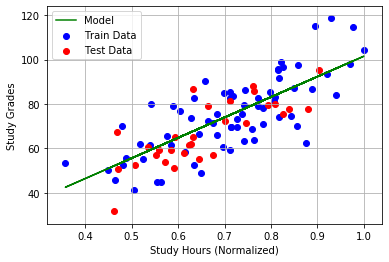

[ 67.84435149 101.48917361  84.55093218  63.44334895  87.17146265
  79.4172244   77.84810745  42.50079659  81.57140876  80.62370775
  63.69866198  75.12355163  96.06714718  50.92767694  76.36697753
  70.61862309  57.89650302  89.98867432  85.1068925   75.67312334
  88.3801298   78.04959458  99.42754739  68.99877241  68.01601375
  85.59781377  73.90824029  66.23020451  61.32461818  53.8969489
  79.72265518  81.65502032  56.11939124  75.18995819  59.29942546
  82.94417211  87.74857486  52.33779441  77.83219279  91.24669835
  72.53321261  57.25197031  98.84523319  95.05773619  67.39576204
  77.35393388  91.90260176  60.53780521  74.99843332  73.5847145
  69.23112887  54.50866269  72.47474656  88.34345584  83.90759395
  94.13292726  84.73680526  84.73669349  71.65366332  75.31577744
  70.02993136  53.61058961  75.04222649  80.53329475  83.7227496
  76.36708871  84.48303233  59.44858193  62.68348061  65.07984941]
[ 67.84434895 101.48918162  84.55093488  63.44334503  87.17146617
  79.4172254

  76.36709275  84.48311486  59.44842235  62.68335231  65.07974429]
[ 67.84427181 101.48942472  84.55101675  63.443226    87.17157299
  79.4172585   77.84812612  42.50046774  81.57146404  80.62375371
  63.69854153  75.12354352  96.06734497  50.92743093  76.36698164
  70.61857068  57.89632554  89.98881235  85.10698254  75.67312062
  88.38025202  78.04961523  99.42777822  68.99870408  68.01593575
  85.59790863  73.90822023  66.23010896  61.32447439  53.89673209
  79.72269229  81.65507642  56.11919628  75.18995072  59.29926177
  82.94424088  87.74869087  52.33756227  77.8322113   91.24684876
  72.53317902  57.25178649  98.84545829  95.05792406  67.39567794
  77.35394769  91.90275861  60.5376537   74.99842397  73.58469126
  69.23106282  54.5084519   72.4747124   88.34357769  83.9076722
  94.13310604  84.73689166  84.73677989  71.65362109  75.31577122
  70.02987316  53.61036999  75.04221757  80.53333982  83.72282602
  76.36709282  84.48311623  59.44841971  62.68335018  65.07974255]
[ 67.8442

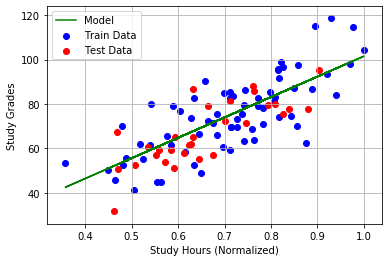

[ 67.84426326 101.48945164  84.55102582  63.44321281  87.17158482
  79.41726215  77.84812813  42.50043247  81.57146997  80.62375864
  63.69852862  75.12354265  96.06736619  50.92740455  76.36698208
  70.61856506  57.8963065   89.98882716  85.10699219  75.67312033
  88.38026513  78.04961745  99.42780298  68.99869675  68.01592739
  85.59791881  73.90821808  66.23009871  61.32445897  53.89670884
  79.72269626  81.65508243  56.11917537  75.18994992  59.29924421
  82.94424826  87.74870331  52.33753738  77.83221329  91.24686489
  72.53317542  57.25176678  98.84548244  95.05794421  67.39566892
  77.35394917  91.90277543  60.53763745  74.99842297  73.58468877
  69.23105574  54.50842929  72.47470874  88.34359076  83.90768059
  94.13312521  84.73690093  84.73678915  71.65361656  75.31577055
  70.02986692  53.61034643  75.04221662  80.53334465  83.72283422
  76.36709326  84.48312523  59.44840231  62.6833362   65.07973109]
Iteration: 700 and Error:247.551801 

[ 67.84426212 101.48945525  84.551027

[ 67.8442452  101.48950855  84.55104499  63.44318495  87.17160983
  79.41726988  77.84813236  42.50035795  81.5714825   80.62376906
  63.69850132  75.12354081  96.06741101  50.9273488   76.36698301
  70.61855318  57.89626628  89.98885844  85.1070126   75.67311972
  88.38029283  78.04962213  99.42785529  68.99868127  68.01590971
  85.59794031  73.90821353  66.23007706  61.32442639  53.89665971
  79.72270467  81.65509515  56.11913119  75.18994823  59.29920712
  82.94426384  87.7487296   52.33748477  77.83221748  91.24689897
  72.53316781  57.25172512  98.84553345  95.05798678  67.39564987
  77.3539523   91.90281098  60.53760311  74.99842085  73.5846835
  69.23104077  54.50838152  72.474701    88.34361838  83.90769832
  94.13316572  84.73692051  84.73680873  71.65360699  75.31576914
  70.02985373  53.61029666  75.0422146   80.53335486  83.72285154
  76.36709419  84.48314424  59.44836554  62.68330664  65.07970687]
[ 67.84424434 101.48951126  84.5510459   63.44318362  87.17161102
  79.41727

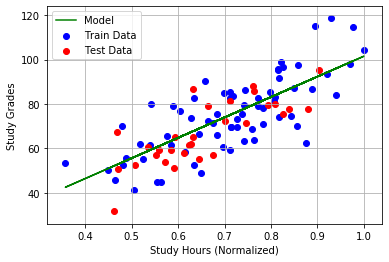

[ 67.84422349 101.48957698  84.55106803  63.44315144  87.17163989
  79.41727917  77.84813745  42.50026833  81.57149756  80.62378158
  63.6984685   75.1235386   96.06746491  50.92728176  76.36698413
  70.6185389   57.89621791  89.98889605  85.10703713  75.67311898
  88.38032613  78.04962776  99.42791819  68.99866265  68.01588846
  85.59796616  73.90820806  66.23005102  61.32438721  53.89660062
  79.72271478  81.65511044  56.11907806  75.1899462   59.29916251
  82.94428259  87.74876122  52.33742151  77.83222253  91.24693996
  72.53315866  57.25167502  98.84559479  95.05803798  67.39562695
  77.35395606  91.90285372  60.53756182  74.99841831  73.58467716
  69.23102277  54.50832407  72.47469169  88.34365159  83.90771964
  94.13321444  84.73694405  84.73683227  71.65359548  75.31576744
  70.02983787  53.61023681  75.04221217  80.53336715  83.72287237
  76.36709531  84.48316711  59.44832134  62.6832711   65.07967775]
[ 67.84422297 101.4895786   84.55106858  63.44315065  87.17164061
  79.4172

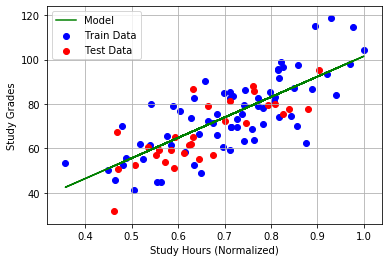

[ 67.84420556 101.48963348  84.55108706  63.44312378  87.17166472
  79.41728685  77.84814165  42.50019434  81.57151     80.62379192
  63.6984414   75.12353677  96.06750942  50.92722641  76.36698506
  70.61852711  57.89617798  89.98892711  85.10705739  75.67311837
  88.38035363  78.0496324   99.42797013  68.99864727  68.01587091
  85.5979875   73.90820355  66.23002952  61.32435486  53.89655184
  79.72272313  81.65512306  56.1190342   75.18994452  59.29912568
  82.94429806  87.74878732  52.33736928  77.8322267   91.2469738
  72.5331511   57.25163366  98.84564544  95.05808025  67.39560803
  77.35395917  91.90288901  60.53752773  74.9984162   73.58467193
  69.23100791  54.50827665  72.474684    88.343679    83.90773725
  94.13325467  84.73696349  84.73685171  71.65358598  75.31576604
  70.02982478  53.61018739  75.04221016  80.53337729  83.72288957
  76.36709623  84.48318599  59.44828483  62.68324175  65.0796537 ]
Iteration: 800 and Error:247.551801 

[ 67.84420533 101.48963421  84.5510873

[ 67.84419791 101.48965757  84.55109518  63.44311198  87.1716753
  79.41729012  77.84814344  42.50016279  81.5715153   80.62379633
  63.69842985  75.12353599  96.06752839  50.92720281  76.36698545
  70.61852208  57.89616095  89.98894036  85.10706603  75.67311811
  88.38036536  78.04963438  99.42799228  68.99864071  68.01586342
  85.5979966   73.90820162  66.23002035  61.32434106  53.89653104
  79.72272669  81.65512844  56.11901549  75.1899438   59.29910997
  82.94430466  87.74879845  52.33734701  77.83222847  91.24698823
  72.53314788  57.25161603  98.84566704  95.05809828  67.39559996
  77.3539605   91.90290406  60.53751319  74.99841531  73.5846697
  69.23100157  54.50825642  72.47468072  88.3436907   83.90774476
  94.13327182  84.73697178  84.73686     71.65358193  75.31576544
  70.02981919  53.61016632  75.0422093   80.53338161  83.7228969
  76.36709663  84.48319404  59.44826927  62.68322924  65.07964345]
[ 67.8441978  101.48965792  84.55109529  63.44311181  87.17167546
  79.4172901

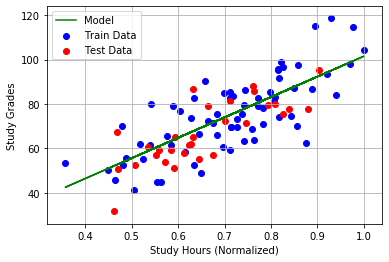

[ 67.84419748 101.48965894  84.55109564  63.44311131  87.17167591
  79.4172903   77.84814354  42.50016099  81.5715156   80.62379659
  63.69842919  75.12353595  96.06752948  50.92720146  76.36698548
  70.61852179  57.89615997  89.98894111  85.10706652  75.67311809
  88.38036603  78.0496345   99.42799354  68.99864034  68.015863
  85.59799712  73.90820151  66.23001983  61.32434027  53.89652985
  79.72272689  81.65512875  56.11901442  75.18994376  59.29910908
  82.94430504  87.74879909  52.33734573  77.83222857  91.24698905
  72.5331477   57.25161502  98.84566828  95.05809931  67.3955995
  77.35396057  91.90290492  60.53751236  74.99841526  73.58466958
  69.23100121  54.50825527  72.47468054  88.34369136  83.90774519
  94.1332728   84.73697225  84.73686048  71.6535817   75.31576541
  70.02981888  53.61016512  75.04220926  80.53338186  83.72289732
  76.36709665  84.4831945   59.44826838  62.68322852  65.07964286]
[ 67.84419737 101.48965927  84.55109575  63.44311114  87.17167605
  79.4172903

[ 67.84419598 101.48966365  84.55109722  63.443109    87.17167798
  79.41729094  77.84814389  42.50015483  81.57151664  80.62379745
  63.69842693  75.12353579  96.06753318  50.92719685  76.36698555
  70.61852081  57.89615665  89.9889437   85.10706821  75.67311804
  88.38036832  78.04963488  99.42799787  68.99863906  68.01586154
  85.5979989   73.90820114  66.23001804  61.32433758  53.89652579
  79.72272759  81.6551298   56.11901077  75.18994362  59.29910601
  82.94430632  87.74880126  52.33734138  77.83222892  91.24699187
  72.53314707  57.25161157  98.84567249  95.05810283  67.39559792
  77.35396083  91.90290786  60.53750952  74.99841508  73.58466914
  69.23099997  54.50825132  72.4746799   88.34369365  83.90774665
  94.13327615  84.73697387  84.7368621   71.65358091  75.31576529
  70.02981779  53.610161    75.04220909  80.5333827   83.72289875
  76.36709673  84.48319607  59.44826534  62.68322608  65.07964086]
[ 67.8441959  101.48966391  84.55109731  63.44310888  87.17167809
  79.4172

In [27]:
if __name__ == '__main__':
    m,count = Calculate_Parameters(alpha, t, x_train, y_train, x_test, y_test,
                                   RUN_OPTIMIZATION  = True, 
                                   Print_Updates     = True, 
                                   Plot_Fitted_Model = True, 
                                   Plot_Gradient     = False)

In [28]:
# Check the effect of changing the alpha parameter
alpha = [.1, .2, .3, .4, .5, .6, .7, .8, .9]                 # Learning Rate
Iteration = []
if __name__ == '__main__':
    for i in alpha:
        m,Iters = Calculate_Parameters(i, t, x_train, y_train, x_test, y_test,
                                       RUN_OPTIMIZATION  = True, 
                                       Print_Updates     = False, 
                                       Plot_Fitted_Model = False, 
                                       Plot_Gradient     = False)
        Iteration.append(Iters)

[-0.34264335 -0.42068063 -0.38139333 -0.33243547 -0.3874715  -0.36948598
 -0.3658465  -0.2838604  -0.37448249 -0.37228435 -0.33302766 -0.35952705
 -0.40810454 -0.30340607 -0.3624111  -0.34907812 -0.31956988 -0.39400587
 -0.38268285 -0.36080175 -0.39027494 -0.36631384 -0.4158988  -0.34532097
 -0.34304151 -0.38382151 -0.3567082  -0.33889943 -0.3275212  -0.31029313
 -0.37019441 -0.37467642 -0.31544796 -0.35968107 -0.32282388 -0.37766654
 -0.38881008 -0.30667676 -0.36580959 -0.39692378 -0.3535189  -0.31807492
 -0.41454816 -0.40576327 -0.34160287 -0.36470029 -0.39844511 -0.32569623
 -0.35923684 -0.3559578  -0.3458599  -0.31171197 -0.35338329 -0.39018987
 -0.37990114 -0.40361823 -0.38182445 -0.38182419 -0.35147884 -0.35997291
 -0.34771268 -0.30962894 -0.35933842 -0.37207464 -0.37947241 -0.36241136
 -0.38123584 -0.32316984 -0.330673   -0.33623124]
[21.7825111  25.77831428 23.76665618 21.25982919 24.0778816  23.15695505
 22.9706     18.77260197 23.41279521 23.30024218 21.29015126 22.64702008
 

 81.87814537 64.48513933 66.73262674 68.39753475]
[70.31168949 93.71392238 81.93223813 67.25049672 83.75499304 78.36139967
 77.26997347 52.68354536 79.85977954 79.20058985 67.42808407 75.37486196
 89.94253893 58.54500646 76.23974816 72.24138167 63.39229293 85.71455291
 82.31894587 75.75712598 84.59570219 77.4101213  92.27992291 71.11466676
 70.43109212 82.66041457 74.52953132 69.18894189 65.7767772  60.61033449
 78.57384729 79.91793699 62.15619236 75.42105217 64.36811969 80.81462862
 84.15641333 59.52583785 77.25890376 86.5895931  73.57310724 62.94397715
 91.87488428 89.24042581 69.99966541 76.92624257 87.04581796 65.22949596
 75.28783377 74.30449741 71.27628628 61.0358225  73.53244017 84.57019299
 81.4847532  88.5971591  82.06152534 82.0614476  72.96132165 75.50856792
 71.83190704 60.41115237 75.31829486 79.13770153 81.35618154 76.23982549
 81.88500923 64.47186803 66.72195726 68.38879267]
[70.30518807 93.73441012 81.93913838 67.2404649  83.76399541 78.36418176
 77.27149685 52.65671387

 83.22550317 61.88001865 64.63823696 66.68148746]
[69.03547762 97.73561213 83.28673777 65.2812784  85.52213604 78.90751701
 77.56900889 47.41659577 80.74510678 79.9366868  65.49906877 75.2448736
 93.11044611 54.60500052 76.30555659 71.40202209 60.54963727 87.92530981
 83.76099013 75.71367625 86.55316868 77.74088401 95.97697748 70.02023645
 69.18191114 84.17976204 74.20817325 67.65855741 63.4739317  57.13788669
 79.16805946 80.81643017 59.03370275 75.30152056 61.74637603 81.91611884
 86.01443165 55.80787688 77.55543316 88.99844548 73.03522962 59.99982977
 95.4802444  92.2493855  68.65281613 77.14746265 89.55795256 62.80275449
 75.13814358 73.93219516 70.21844411 57.65969858 72.98535617 86.52188459
 82.73794921 91.46049321 83.4452936  83.44519825 72.28494529 75.40884851
 70.89984878 56.89361285 75.17550059 79.85956154 82.58027092 76.30565142
 83.22881698 61.87361138 64.63308583 66.67726686]
[69.03233879 97.74550343 83.29006915 65.27643513 85.52648231 78.90886018
 77.56974437 47.40364176 

 83.91023622 60.55608507 63.57385903 65.80938481]
[68.38690123 99.77945223 83.97510034 64.28051314 86.42020575 79.1850562
 77.72097998 44.73990923 81.1950339  80.31077444 64.51873486 75.17881295
 94.72039023 52.60267248 76.33900072 70.97545593 59.10498738 89.04882601
 84.49384325 75.69159491 87.54796161 77.90897904 97.85583658 69.46404224
 68.54707197 84.95190098 74.04485768 66.88080941 62.30361567 55.37317372
 79.47004066 81.27304829 57.44684004 75.24077408 60.41399458 82.47590093
 86.95868458 53.91839306 77.70613069 90.22263467 72.7618779  58.50360135
 97.31250399 93.77855181 67.96834151 77.25988766 90.83463021 61.569474
 75.06207038 73.74298955 69.68084416 55.94393782 72.70732572 87.51374269
 83.37482884 92.91565197 84.1485306  84.14842631 71.94120791 75.35817067
 70.42617275 55.10598406 75.10293192 80.22641391 83.20235844 76.33910445
 83.91174588 60.55316613 63.57151235 65.80746204]
[68.38547128 99.78395838 83.97661801 64.27830671 86.42218577 79.1856681
 77.72131504 44.73400782 81.

  76.35351094  84.20584809  59.98451857  63.11434748  65.43288204]
[ 68.10689886 100.66181563  84.27227914  63.84846436  86.80791898
  79.30487497  77.7865887   43.58433437  81.38927573  80.47227497
  64.09550666  75.15029335  95.41543274  51.7382306   76.35343916
  70.79129947  58.48130543  89.53386864  84.81022943  75.68206199
  87.97743203  77.98154876  98.66697465  69.22392296  68.27300022
  85.28524758  73.97435135  66.54504128  61.79836869  54.61131465
  79.6004115   81.47017873  56.7617622   75.2145487   59.83878098
  82.71756917  87.36633596  53.1026681   77.77118958  90.75113968
  72.64386693  57.857652    98.10352419  94.43872106  67.67284122
  77.3084236   91.38579546  61.0370441   75.02922818  73.661306
  69.44875236  55.20321231  72.58729485  87.94194609  83.64978149
  93.5438708   84.45213096  84.45202281  71.79281015  75.33629212
  70.22167808  54.33423181  75.07160269  80.38479084  83.47092507
  76.35354673  84.20657886  59.98310561  63.11321153  65.43195129]
[ 68.10620

  76.36105287  84.35981343  59.68682607  62.87501726  65.23678579]
[ 67.96106351 101.12138238  84.42706059  63.62343774  87.00985404
  79.36728092  77.82076009  42.98246922  81.49044389  80.55639028
  63.87507412  75.13543932  95.777436    51.28799802  76.36095923
  70.69538413  58.15646933  89.78649637  84.97501479  75.6770969
  88.20111574  78.0193457   99.08944467  69.09886016  68.13025374
  85.45886653  73.9376291   66.3701611   61.53521781  54.2145109
  79.66831334  81.5728514   56.40494889  75.20088958  59.53918894
  82.84343872  87.57865553  52.67780906  77.80507461  91.02640419
  72.58240255  57.52121823  98.5155161   94.78256106  67.51893398
  77.33370287  91.67286224  60.75973537  75.01212277  73.61876226
  69.32787056  54.81741569  72.52477844  88.1649699   83.79298678
  93.87106987  84.61025701  84.61014684  71.71551923  75.32489697
  70.11516987  53.93227534  75.0552853   80.46727926  83.61080428
  76.3610688   84.36013854  59.68619748  62.8745119   65.23637172]
[ 67.96075

[ 67.89550339 101.3279801   84.49664242  63.52227727  87.10063372
  79.39533545  77.8361218   42.71190142  81.53592392  80.59420422
  63.77597892  75.1287617   95.94017416  51.08559648  76.36433986
  70.65226549  58.01043962  89.90006488  85.04909386  75.67486485
  88.30167251  78.03633727  99.27936559  69.04263832  68.06608222
  85.53691674  73.92112066  66.29154392  61.41691862  54.03612823
  79.69883854  81.61900778  56.24454388  75.19474914  59.40450768
  82.90002323  87.67410355  52.48681416  77.82030758  91.15014904
  72.5547713   57.36997481  98.7007266   94.93713395  67.44974516
  77.34506714  91.80191279  60.63507154  75.00443306  73.59963677
  69.27352829  54.64398126  72.49667426  88.26523     83.85736455
  94.01816184  84.68134239  84.68123132  71.68077319  75.3197743
  70.06728922  53.75157626  75.04794983  80.50436184  83.67368682
  76.36445033  84.42917111  59.55272277  62.76720475  65.14844915]
[ 67.89536819 101.32840615  84.49678592  63.52206866  87.10082093
  79.39539

  76.3659102   84.45897363  59.49509951  62.72087846  65.1104915 ]
[ 67.86713937 101.41736282  84.5267464   63.47851107  87.13990877
  79.407473    77.84276791  42.59484259  81.55560047  80.6105641
  63.73310623  75.12587269  96.01058142  50.99802919  76.36580247
  70.63361059  57.94726113  89.94919932  85.08114354  75.67389917
  88.34517752  78.04368852  99.36153324  69.01831443  68.03831897
  85.57068449  73.91397842  66.25753087  61.3657375   53.9589525
  79.71204501  81.63897694  56.17514603  75.19209253  59.34623899
  82.92450404  87.71539832  52.40418186  77.826898    91.20368619
  72.54281688  57.30454064  98.78085632  95.00400858  67.41981121
  77.3499838   91.8577454   60.58113681  75.00110617  73.59136229
  69.25001757  54.56894634  72.48451522  88.30860667  83.88521704
  94.08179992  84.71209687  84.71198541  71.66574061  75.31755802
  70.04657407  53.67339836  75.0447762   80.5204053   83.70089241
  76.36591333  84.45903746  59.49497608  62.72077923  65.1104102 ]
[ 67.86707

[ 67.85515388 101.45513234  84.53946712  63.46001724  87.15650481
  79.41260183  77.84557629  42.54537827  81.56391498  80.61747712
  63.71498997  75.12465191  96.04033268  50.96102681  76.3664205
  70.62572778  57.92056446  89.96996154  85.09468643  75.67349111
  88.36356098  78.04679487  99.39625396  69.00803613  68.02658734
  85.58495337  73.9109604   66.24315833  61.34411043  53.92634116
  79.71762552  81.64741509  56.14582131  75.19096995  59.32161701
  82.93484863  87.73284781  52.3692648   77.82968284  91.22630881
  72.53776543  57.27689082  98.8147159   95.03226709  67.40716234
  77.35206138  91.881338    60.55834618  74.99970036  73.58786583
  69.24008289  54.53723963  72.47937731  88.3269359   83.89698637
  94.10869079  84.72509246  84.72498084  71.65938846  75.31662151
  70.03782069  53.64036355  75.04343516  80.52718462  83.71238839
  76.36653153  84.47165777  59.47057467  62.70116169  65.09433648]
[ 67.855125   101.45522336  84.53949778  63.45997267  87.15654481
  79.41261

  76.36678302  84.47679186  59.46064789  62.69318105  65.08779751]
[ 67.85026201 101.47054797  84.54465909  63.45246899  87.16327849
  79.41469517  77.84672253  42.52518941  81.56730855  80.62029867
  63.70759582  75.12415365  96.05247565  50.94592428  76.36667275
  70.62251041  57.90966821  89.97843565  85.10021396  75.67332456
  88.37106419  78.04806272  99.41042522  69.00384105  68.02179908
  85.59077722  73.9097286   66.23729218  61.33528334  53.91303085
  79.71990321  81.65085913  56.13385242  75.19051177  59.31156754
  82.93907078  87.73996983  52.3550134   77.83081947  91.23554224
  72.53570368  57.26560554  98.82853569  95.0438008   67.4019997
  77.35290934  91.89096732  60.54904418  74.99912658  73.58643875
  69.23602805  54.52429853  72.47728027  88.33441697  83.90179003
  94.1196663   84.73039662  84.73028493  71.65679582  75.31623927
  70.034248    53.62688039  75.04288781  80.5299516   83.71708047
  76.36678385  84.47680875  59.46061524  62.69315479  65.087776  ]
[ 67.8502

[ 67.84742251 101.47949601  84.54767278  63.44808758  87.16721028
  79.41591025  77.84738787  42.51347074  81.56927835  80.62193645
  63.70330387  75.12386443  96.05952408  50.93715798  76.36681918
  70.62064288  57.90334346  89.98335446  85.10342243  75.67322789
  88.37541945  78.04879865  99.41865097  69.001406    68.01901972
  85.59415768  73.90901359  66.23388716  61.33015964  53.90530484
  79.7212253   81.65285823  56.12690505  75.19024582  59.30573431
  82.94152153  87.74410381  52.34674114  77.83147923  91.2409018
  72.53450693  57.25905497  98.83655742  95.05049557  67.39900303
  77.35340154  91.89655668  60.54364481  74.99879353  73.5856104
  69.23367441  54.51678684  72.47606304  88.33875938  83.90457832
  94.12603706  84.73347543  84.7333637   71.65529092  75.3160174
  70.03217422  53.61905405  75.0425701   80.53155769  83.719804
  76.36693031  84.47979865  59.45483426  62.68850717  65.08396794]
[ 67.84741399 101.47952284  84.54768181  63.44807445  87.16722207
  79.41591389 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[68.62302256 99.03536987 83.72449441 64.64485269 86.09325364 79.08401501
 77.66565324 45.71438626 81.03123301 80.17458374 64.87563615 75.20286305
 94.13427245 53.33164192 76.32682502 71.13075201 59.63092799 88.63979764
 84.22704005 75.69963386 87.18579635 77.8477822  97.17181736 69.66653083
 68.77819212 84.67079535 74.1043145  67.16395708 62.72968203 56.0156368
 79.3601011  81.10681146 58.02455478 75.2628895  60.89906263 82.27210614
 86.61491896 54.60628033 77.6512676  89.77695519 72.86139459 59.04831969
 96.64544983 93.22184207 68.21753199 77.2189581  90.36984174 62.01846326
 75.08976566 73.81187192 69.87656331 56.5685793  72.80854575 87.15264589
 83.14296584 92.38588549 83.89250947 83.89240844 72.06634927 75.37662049
 70.59861969 55.75678989 75.12935134 80.09285729 82.97588067 76.32692551
 83.66311814 61.03388868 63.9579898  66.12412401]
[68.6189184  99.04830321 83.72885035 64.63851989 86.09893659 79.08577127
 77.66661491 45.69744829 81.03408013 80.17695095 64.86943263 75.20244502
 

  76.36018177  84.3420302   59.72121     62.90266026  65.2594352 ]
[ 67.97755446 101.06941492  84.40955802  63.64888358  86.98701938
  79.36022411  77.81689602  43.05052768  81.47900387  80.54687858
  63.90000047  75.137119    95.73650094  51.33890999  76.36010886
  70.70623016  58.19320155  89.75792942  84.95638099  75.67765835
  88.17582176  78.01507165  99.04167208  69.11300217  68.1463954
  85.43923383  73.94178163  66.38993642  61.56497471  54.25938117
  79.66063505  81.56124125  56.44529707  75.20243414  59.57306658
  82.82920548  87.55464659  52.7258518   77.80124291  90.99527749
  72.58935289  57.55926191  98.46892836  94.74367989  67.5363377
  77.33084431  91.64040095  60.79109323  75.01405704  73.62357307
  69.34153978  54.86104128  72.53184775  88.13975054  83.77679323
  93.83407044  84.59237623  84.59226629  71.72425923  75.32618553
  70.12721374  53.97772827  75.05713046  80.45795154  83.59498684
  76.36021821  84.34277412  59.71977163  62.90150387  65.25848771]
[ 67.97685

  76.36573849  84.45546825  59.50187717  62.72632737  65.11495609]
[ 67.87039025 101.40711841  84.5232961   63.48352724  87.13540734
  79.40608188  77.84200618  42.60825904  81.55334528  80.60868905
  63.73802     75.12620381  96.00251184  51.00806553  76.36563483
  70.63574868  57.9545022   89.94356788  85.07747023  75.67400985
  88.34019129  78.04284597  99.35211577  69.02110226  68.04150099
  85.56681427  73.91479701  66.2614292   61.37160351  53.96779783
  79.71053138  81.63668821  56.18309991  75.19239701  59.35291733
  82.92169822  87.71066541  52.41365259  77.82614265  91.19755014
  72.54418701  57.31204024  98.77167243  94.99634389  67.42324202
  77.34942029  91.85134626  60.58731842  75.00148747  73.59231065
  69.2527122   54.57754631  72.4859088   88.30363515  83.88202479
  94.07450618  84.70857201  84.70846059  71.66746354  75.31781204
  70.04894829  53.68235855  75.04513994  80.51856652  83.6977743
  76.36574565  84.4556144   59.50159459  62.7261002   65.11476995]
[ 67.8702

  76.36680349  84.47720967  59.45984005  62.69253158  65.08726537]
[ 67.84985127 101.47184232  84.54509502  63.45183521  87.16384723
  79.41487093  77.84681877  42.52349428  81.56759348  80.62053558
  63.70697498  75.12411181  96.05349523  50.94465622  76.36669393
  70.62224027  57.90875332  89.97914716  85.10067807  75.67331058
  88.37169419  78.04816917  99.4116151   69.00348881  68.02139704
  85.59126621  73.90962517  66.23679963  61.33454219  53.91191326
  79.72009445  81.6511483   56.13284747  75.1904733   59.31072375
  82.93942529  87.74056782  52.3538168   77.83091491  91.23631751
  72.53553057  57.26465799  98.82969605  95.04476921  67.40156622
  77.35298054  91.89177583  60.54826315  74.9990784   73.58631892
  69.23568759  54.52321195  72.47710419  88.33504511  83.90219336
  94.12058785  84.73084197  84.73073028  71.65657813  75.31620718
  70.03394802  53.62574829  75.04284185  80.53018392  83.71747444
  76.36680503  84.47724125  59.459779    62.6924825   65.08722515]
[ 67.849

  76.36703556  84.48194734  59.45067977  62.68516716  65.08123129]
[ 67.84537563 101.48594628  84.54984522  63.44492921  87.17004455
  79.41678615  77.84786748  42.50502323  81.5706983   80.62311705
  63.70020998  75.12365595  96.06460499  50.93083872  76.36692472
  70.61929666  57.8987842   89.98690023  85.10573529  75.6731582
  88.37855897  78.04932915  99.42458057  68.99965068  68.01701619
  85.59659452  73.90849818  66.23143262  61.32646617  53.89973548
  79.72217834  81.65429929  56.12189698  75.19005411  59.30152937
  82.94328818  87.74708384  52.34077801  77.83195483  91.24476529
  72.53364425  57.25433294  98.84233995  95.05532155  67.39684286
  77.35375635  91.90058582  60.53975263  74.99855344  73.58501327
  69.23197777  54.51137197  72.47518558  88.34188964  83.90658828
  94.13062948  84.73569481  84.73558305  71.6542061   75.31585747
  70.03067932  53.61341237  75.04234108  80.53271547  83.72176729
  76.36703588  84.48195395  59.45066699  62.68515689  65.08122288]
[ 67.8453

  76.36708119  84.48287891  59.44887857  62.68371909  65.08004481]
[ 67.84449558 101.48871955  84.55077925  63.44357128  87.17126314
  79.41716274  77.84807369  42.50139125  81.57130881  80.62362465
  63.69887977  75.12356631  96.06678952  50.92812177  76.3669701
  70.61871785  57.89682397  89.98842472  85.10672969  75.67312824
  88.3799088   78.04955724  99.42712998  68.99889598  68.01615478
  85.59764223  73.90827657  66.2303773   61.32487817  53.89734095
  79.7225881   81.65491888  56.11974378  75.18997168  59.29972146
  82.94404775  87.74836509  52.33821418  77.83215931  91.24642639
  72.53327334  57.25230272  98.84482613  95.05739647  67.3959141
  77.3539089   91.90231814  60.5380792   74.99845022  73.58475654
  69.2312483   54.50904386  72.47480833  88.34323549  83.90745246
  94.13260398  84.73664903  84.73653726  71.65373969  75.3157887
  70.03003659  53.61098675  75.04224261  80.53321325  83.72261139
  76.36708127  84.48288061  59.44887528  62.68371644  65.08004264]
[ 67.844493

  76.36709343  84.48312878  59.44839544  62.68333068  65.07972656]
[ 67.84425952 101.48946342  84.55102979  63.44320705  87.17158999
  79.41726375  77.848129    42.50041705  81.57147256  80.6237608
  63.69852297  75.12354227  96.06737546  50.92739302  76.36698228
  70.6185626   57.89629818  89.98883363  85.10699641  75.6731202
  88.38027086  78.04961842  99.4278138   68.99869355  68.01592373
  85.59792325  73.90821713  66.23009423  61.32445223  53.89669867
  79.722698    81.65508506  56.11916623  75.18994957  59.29923654
  82.94425148  87.74870875  52.33752649  77.83221416  91.24687194
  72.53317385  57.25175816  98.84549299  95.05795302  67.39566498
  77.35394982  91.90278279  60.53763034  74.99842253  73.58468768
  69.23105264  54.50841941  72.47470714  88.34359648  83.90768426
  94.13313359  84.73690498  84.7367932   71.65361458  75.31577026
  70.02986419  53.61033613  75.0422162   80.53334676  83.7228378
  76.36709345  84.48312916  59.4483947   62.68333008  65.07972607]
[ 67.844259

[ 67.84420545 101.48963382  84.55108718  63.44312361  87.17166487
  79.41728689  77.84814167  42.50019389  81.57151007  80.62379199
  63.69844123  75.12353676  96.06750969  50.92722607  76.36698506
  70.61852704  57.89617773  89.9889273   85.10705752  75.67311836
  88.3803538   78.04963243  99.42797045  68.99864718  68.0158708
  85.59798763  73.90820352  66.23002939  61.32435466  53.89655154
  79.72272318  81.65512314  56.11903393  75.18994451  59.29912545
  82.94429815  87.74878748  52.33736896  77.83222672  91.246974
  72.53315106  57.25163341  98.84564576  95.05808051  67.39560791
  77.35395919  91.90288923  60.53752752  74.99841619  73.5846719
  69.23100782  54.50827635  72.47468395  88.34367917  83.90773736
  94.13325491  84.73696361  84.73685183  71.65358592  75.31576603
  70.0298247   53.61018709  75.04221015  80.53337735  83.72288967
  76.36709624  84.4831861   59.44828461  62.68324157  65.07965355]
[ 67.84420537 101.48963407  84.55108726  63.44312349  87.17166498
  79.41728693

 83.70186034 60.95898052 63.89776729 66.07478044]
[68.58036375 99.16979937 83.76977009 64.57902936 86.15232238 79.1022696
 77.67564884 45.53833256 81.06082607 80.19918861 64.81115665 75.19851805
 94.2401633  53.1999428  76.32902474 71.10269548 59.53590903 88.71369467
 84.27524199 75.69818151 87.25122687 77.85883832 97.29539556 69.62994827
 68.73643684 84.72158124 74.09357275 67.11280226 62.65270684 55.89956633
 79.37996331 81.13684461 57.92018206 75.25889402 60.8114279  82.30892468
 86.67702531 54.4820033  77.66117943 89.85747379 72.84341542 58.94990826
 96.76596305 93.32241993 68.17251204 77.22635263 90.45381266 61.9373467
 75.0847621  73.7994273  69.84120374 56.45572857 72.79025885 87.21788337
 83.18485532 92.48159565 83.93876348 83.93866186 72.04374063 75.37328726
 70.5674646  55.63921218 75.12457828 80.11698627 83.01679723 76.32912581
 83.70803642 60.94703903 63.88816692 66.06691433]
[68.57454469 99.18813679 83.77594611 64.57005045 86.1603799  79.10475969
 77.67701233 45.51431721 8

  76.36294861  84.39851408  59.61199823  62.81485933  65.18749513]
[ 67.92398258 101.23823445  84.46641621  63.56622118  87.0611992
  79.38314862  77.8294487   42.82943556  81.51616748  80.57777792
  63.81902568  75.13166245  95.86948101  51.17351932  76.36287132
  70.67099614  58.07387465  89.85073094  85.01691406  75.67583444
  88.25799084  78.02895616  99.1968643   69.06706098  68.09395821
  85.50301188  73.9282919   66.32569507  61.46830756  54.11361732
  79.68557845  81.59895753  56.31422351  75.19741653  59.46301296
  82.87544303  87.63264111  52.56978198  77.81369041  91.09639451
  72.56677426  57.43567466  98.62027151  94.86998778  67.47980065
  77.34013053  91.74585348  60.68922527  75.00777346  73.60794484
  69.29713447  54.71932084  72.50888266  88.22167721  83.82939897
  93.95426537  84.65046303  84.65035236  71.69586681  75.32199958
  70.08808848  53.83007159  75.05113634  80.48825324  83.64637076
  76.3629814   84.39918349  59.61070393  62.81381877  65.18664254]
[ 67.9233

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 68.02643812 100.91536927  84.35767566  63.72431195  86.91933124
  79.33930578  77.80544185  43.25227141  81.44509255  80.51868334
  63.97388892  75.14209804  95.61515834  51.48982684  76.35758816
  70.73838075  58.30208582  89.67324922  84.90114534  75.67932263
  88.10084352  78.00240221  98.90006116  69.15492291  68.19424367
  85.38103718  73.95409083  66.44855583  61.65318225  54.39238882
  79.63787452  81.52682562  56.56490002  75.20701265  59.6734891
  82.78701432  87.48347759  52.86826351  77.78988474  90.9030095
  72.6099556   57.67203369  98.33082968  94.62842557  67.58792702
  77.32237076  91.54417686  60.88404644  75.01979073  73.63783363
  69.38205907  54.99035936  72.5528031   88.0649935   83.72879117
  93.72439412  84.53937277  84.53926351  71.75016696  75.33000515
  70.16291503  54.1124631   75.06260001  80.43030162  83.54809967
  76.35769683  84.2913013   59.8192945   62.98151541  65.32404551]
[ 68.02403717 100.9229353   84.36022389  63.72060725  86.92265578
  79.340333

  76.36698786  84.48097359  59.45256251  62.6866808   65.0824715 ]
[ 67.8462788  101.48310015  84.54888664  63.44632282  87.16879395
  79.41639967  77.84765586  42.50875062  81.57007176  80.62259612
  63.70157513  75.12374794  96.06236308  50.93362705  76.36687815
  70.61989067  57.90079594  89.98533569  85.10471476  75.67318895
  88.37717368  78.04909507  99.42196418  69.0004252   68.01790023
  85.59551929  73.9087256   66.23251566  61.32809588  53.90219291
  79.72175782  81.65366343  56.12410675  75.1901387   59.30338476
  82.94250866  87.74576893  52.34340919  77.83174498  91.24306056
  72.5340249   57.2564165   98.83978845  95.05319213  67.39779602
  77.35359979  91.89880799  60.54147003  74.99865938  73.58527675
  69.2327264   54.51376124  72.47557275  88.34050844  83.9057014
  94.12860311  84.73471553  84.73460378  71.65468477  75.31592804
  70.03133893  53.61590172  75.04244213  80.53220461  83.720901
  76.3669893   84.48100294  59.45250576  62.68663517  65.08243412]
[ 67.846251

  76.36709429  84.4831464   59.44836137  62.68330329  65.07970412]
[ 67.84424247 101.48951718  84.55104789  63.44318072  87.17161362
  79.41727105  77.848133    42.50034665  81.57148439  80.62377064
  63.69849719  75.12354053  96.06741781  50.92734035  76.36698316
  70.61855138  57.89626018  89.98886318  85.10701569  75.67311962
  88.38029702  78.04962284  99.42786322  68.99867892  68.01590703
  85.59794356  73.90821284  66.23007377  61.32442145  53.89665226
  79.72270595  81.65509707  56.11912449  75.18994797  59.29920149
  82.94426621  87.74873359  52.3374768   77.83221812  91.24690414
  72.53316666  57.2517188   98.84554118  95.05799324  67.39564698
  77.35395277  91.90281637  60.5375979   74.99842053  73.5846827
  69.2310385   54.50837428  72.47469982  88.34362257  83.90770101
  94.13317186  84.73692347  84.7368117   71.65360554  75.31576892
  70.02985173  53.61028912  75.04221429  80.53335641  83.72285417
  76.36709433  84.48314713  59.44835997  62.68330216  65.0797032 ]
[ 67.8442

 83.24098313 61.85009142 64.61417715 66.66177415]
[69.00527334 97.83079014 83.31879299 65.23467315 85.56395704 78.92044071
 77.57608506 47.29194507 80.76605836 79.95410664 65.45341498 75.24179631
 93.18541816 54.51175381 76.30711311 71.38215654 60.4823609  87.97762955
 83.7951172  75.71264702 86.59949395 77.74871104 96.06447254 69.99433429
 69.15234659 84.2157186  74.20056693 67.62233778 63.4194307  57.05570541
 79.1821214  80.83769335 58.95980372 75.29869075 61.68432785 81.94218623
 86.05840333 55.71988518 77.56245002 89.05545343 73.02249907 59.93015146
 95.56556939 92.32059583 68.62094012 77.15269721 89.61740483 62.74532132
 75.13460003 73.92338318 70.19340787 57.57979693 72.97240773 86.56807319
 82.76760693 91.52825711 83.47804149 83.47794573 72.26893697 75.40648758
 70.87778938 56.8103644  75.17212023 79.87664444 82.60923979 76.30720836
 83.26061915 61.81211906 64.58364883 66.63676027]
[68.98691946 97.88863519 83.33827624 65.20635186 85.58937528 78.92829712
 77.58038772 47.216193  

[ 67.85636886 101.45130362  84.53817762  63.46189197  87.15482246
  79.41208192  77.84529161  42.5503925   81.56307213  80.61677634
  63.71682643  75.12477566  96.03731678  50.96477776  76.36635785
  70.62652686  57.92327071  89.96785687  85.09331358  75.67353248
  88.36169744  78.04647997  99.3927343   69.00907805  68.02777658
  85.58350693  73.91126634  66.24461528  61.34630278  53.92964699
  79.71705982  81.64655971  56.14879397  75.19108375  59.32411295
  82.93379999  87.73107895  52.37280436  77.82940054  91.22401555
  72.5382775   57.27969369  98.81128354  95.02940251  67.40844456
  77.35185077  91.8789464   60.56065647  74.99984287  73.58822027
  69.24108997  54.54045375  72.47989814  88.32507785  83.89579331
  94.10596485  84.72377509  84.72366349  71.66003238  75.31671645
  70.03870802  53.6437123   75.0435711   80.5264974   83.71122303
  76.36646886  84.47037845  59.47304826  62.70315033  65.09596588]
[ 67.85617634 101.45191031  84.53838195  63.46159491  87.15508904
  79.4121

  76.36709189  84.48309726  59.44845639  62.68337968  65.07976671]
[ 67.84428826 101.48937286  84.55099929  63.44325139  87.1715502
  79.41725146  77.84812227  42.50053566  81.57145262  80.62374422
  63.69856641  75.12354519  96.06730413  50.92748174  76.36698079
  70.6185815   57.89636219  89.98878385  85.10696394  75.67312118
  88.38022678  78.04961097  99.42773055  68.99871819  68.01595186
  85.59788904  73.90822437  66.23012869  61.32450409  53.89677687
  79.72268462  81.65506483  56.11923654  75.18995226  59.29929558
  82.94422668  87.74866691  52.33761021  77.83220748  91.24681769
  72.53318596  57.25182445  98.84541181  95.05788526  67.39569531
  77.35394484  91.90272622  60.53768499  74.9984259   73.58469606
  69.23107646  54.50849543  72.47471945  88.34355253  83.90765604
  94.13306911  84.73687382  84.73676204  71.65362981  75.3157725
  70.02988518  53.61041534  75.04221941  80.53333051  83.72281024
  76.36709197  84.4830989   59.44845321  62.68337712  65.07976461]
[ 67.84428

 106631.63898654 108051.37188333]
[-122657.96418168 -144915.80469017 -133710.25648084 -119746.46676724
 -135443.87686047 -130314.03555332 -129275.98118068 -105891.853762
 -131739.14316123 -131112.18850515 -119915.36992335 -127473.54249655
 -141328.84562907 -111466.68361102 -128296.13490848 -124493.29249703
 -116076.93296772 -137307.6123197  -134078.05382243 -127837.11342783
 -136243.47450898 -129409.27563898 -143551.92921673 -123421.67506545
 -122771.52790082 -134402.82437047 -126669.54936234 -121590.12004593
 -118344.81359622 -113431.01504893 -130516.09427344 -131794.45665564
 -114901.27894084 -127517.4739656  -117005.04083019 -132647.29917732
 -135825.66730356 -112399.55137187 -129265.45278284 -138139.86217239
 -125759.89536636 -115650.54027735 -143166.6973803  -140661.06653516
 -122361.19838308 -128949.05905736 -138573.77718614 -117824.29494585
 -127390.77007342 -126455.51983472 -123575.39122731 -113835.69627809
 -125721.21696319 -136219.21272864 -133284.65400286 -140049.25620532
 -

 2.24232648e+19 2.27215860e+19]
[-2.58237285e+19 -3.05129447e+19 -2.81521929e+19 -2.52103428e+19
 -2.85174269e+19 -2.74366870e+19 -2.72179928e+19 -2.22914937e+19
 -2.77369245e+19 -2.76048395e+19 -2.52459268e+19 -2.68382603e+19
 -2.97572548e+19 -2.34659824e+19 -2.70115617e+19 -2.62103900e+19
 -2.44372562e+19 -2.89100732e+19 -2.82296793e+19 -2.69148564e+19
 -2.86858838e+19 -2.72460749e+19 -3.02256075e+19 -2.59846248e+19
 -2.58476537e+19 -2.82981010e+19 -2.66688774e+19 -2.55987582e+19
 -2.49150466e+19 -2.38798220e+19 -2.74792562e+19 -2.77485778e+19
 -2.41895729e+19 -2.68475157e+19 -2.46327872e+19 -2.79282521e+19
 -2.85978614e+19 -2.36625163e+19 -2.72157747e+19 -2.90854091e+19
 -2.64772342e+19 -2.43474250e+19 -3.01444480e+19 -2.96165690e+19
 -2.57612067e+19 -2.71491178e+19 -2.91768251e+19 -2.48053853e+19
 -2.68208221e+19 -2.66237863e+19 -2.60170093e+19 -2.39650790e+19
 -2.64690855e+19 -2.86807724e+19 -2.80625282e+19 -2.94876746e+19
 -2.81780987e+19 -2.81780832e+19 -2.63546478e+19 -2.686505

 -5.51817777e+32 -5.59159211e+32]
[6.35500340e+32 7.50898028e+32 6.92801900e+32 6.20405432e+32
 7.01790004e+32 6.75193901e+32 6.69812018e+32 5.48575000e+32
 6.82582493e+32 6.79331993e+32 6.21281125e+32 6.60467120e+32
 7.32301130e+32 5.77478184e+32 6.64731921e+32 6.45015758e+32
 6.01380418e+32 7.11452700e+32 6.94708777e+32 6.62352085e+32
 7.05935586e+32 6.70503095e+32 7.43826898e+32 6.39459865e+32
 6.36089121e+32 6.96392578e+32 6.56298749e+32 6.29964011e+32
 6.13138440e+32 5.87662430e+32 6.76241491e+32 6.82869271e+32
 5.95285139e+32 6.60694887e+32 6.06192273e+32 6.87290906e+32
 7.03769429e+32 5.82314717e+32 6.69757433e+32 7.15767571e+32
 6.51582569e+32 5.99169749e+32 7.41829631e+32 7.28838972e+32
 6.33961733e+32 6.68117063e+32 7.18017241e+32 6.10439767e+32
 6.60037979e+32 6.55189094e+32 6.40256820e+32 5.89760534e+32
 6.51382038e+32 7.05809799e+32 6.90595327e+32 7.25666989e+32
 6.93439422e+32 6.93439039e+32 6.48565821e+32 6.61126431e+32
 6.42996616e+32 5.86680252e+32 6.60188185e+32 6.790

[-6.33577191e+45 -7.48625662e+45 -6.90705345e+45 -6.18527963e+45
 -6.99666249e+45 -6.73150631e+45 -6.67785035e+45 -5.46914904e+45
 -6.80516864e+45 -6.77276201e+45 -6.19401006e+45 -6.58468417e+45
 -7.30085043e+45 -5.75730622e+45 -6.62720312e+45 -6.43063813e+45
 -5.99560523e+45 -7.09299704e+45 -6.92606451e+45 -6.60347677e+45
 -7.03799286e+45 -6.68474021e+45 -7.41575931e+45 -6.37524734e+45
 -6.34164190e+45 -6.94285157e+45 -6.54312659e+45 -6.28057616e+45
 -6.11282963e+45 -5.85884047e+45 -6.74195051e+45 -6.80802774e+45
 -5.93483689e+45 -6.58695494e+45 -6.04357816e+45 -6.85211029e+45
 -7.01639684e+45 -5.80552518e+45 -6.67730615e+45 -7.13601518e+45
 -6.49610752e+45 -5.97356543e+45 -7.39584708e+45 -7.26633362e+45
 -6.32043240e+45 -6.66095209e+45 -7.15844379e+45 -6.08592456e+45
 -6.58040575e+45 -6.53206363e+45 -6.38319277e+45 -5.87975803e+45
 -6.49410827e+45 -7.03673880e+45 -6.88505450e+45 -7.23470978e+45
 -6.91340938e+45 -6.91340556e+45 -6.46603133e+45 -6.59125733e+45
 -6.41050782e+45 -5.84904

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[-1.35929811e+163 -1.60612702e+163 -1.48186280e+163 -1.32701098e+163
 -1.50108783e+163 -1.44420032e+163 -1.43268878e+163 -1.17336988e+163
 -1.46000408e+163 -1.45305145e+163 -1.32888404e+163 -1.41270059e+163
 -1.56634934e+163 -1.23519211e+163 -1.42182275e+163 -1.37965103e+163
 -1.28631759e+163 -1.52175577e+163 -1.48594150e+163 -1.41673242e+163
 -1.50995499e+163 -1.43416696e+163 -1.59100229e+163 -1.36776730e+163
 -1.36055748e+163 -1.48954305e+163 -1.40378469e+163 -1.34745622e+163
 -1.31146731e+163 -1.25697561e+163 -1.44644105e+163 -1.46061748e+163
 -1.27328014e+163 -1.41318777e+163 -1.29660987e+163 -1.47007510e+163
 -1.50532170e+163 -1.24553717e+163 -1.43257203e+163 -1.53098503e+163
 -1.39369706e+163 -1.28158910e+163 -1.58673025e+163 -1.55894399e+163
 -1.35600712e+163 -1.42906337e+163 -1.53579694e+163 -1.30569501e+163
 -1.41178269e+163 -1.40141120e+163 -1.36947194e+163 -1.26146334e+163
 -1.39326813e+163 -1.50968593e+163 -1.47714307e+163 -1.55215930e+163
 -1.48322642e+163 -1.48322560e+163

 1.05105810e+176 1.06504147e+176]
[-1.21044991e+176 -1.43025014e+176 -1.31959331e+176 -1.18169834e+176
 -1.33671313e+176 -1.28605501e+176 -1.27580403e+176 -1.04488152e+176
 -1.30012821e+176 -1.29393692e+176 -1.18336629e+176 -1.25800462e+176
 -1.39482827e+176 -1.09993398e+176 -1.26612787e+176 -1.22857411e+176
 -1.14546103e+176 -1.35511785e+176 -1.32322538e+176 -1.26159495e+176
 -1.34460930e+176 -1.27712034e+176 -1.41678162e+176 -1.21799169e+176
 -1.21157137e+176 -1.32643254e+176 -1.25006505e+176 -1.19990476e+176
 -1.16785676e+176 -1.11933211e+176 -1.28805038e+176 -1.30067444e+176
 -1.13385123e+176 -1.25843846e+176 -1.15462626e+176 -1.30909641e+176
 -1.34048338e+176 -1.10914622e+176 -1.27570006e+176 -1.36333647e+176
 -1.24108205e+176 -1.14125032e+176 -1.41297739e+176 -1.38823383e+176
 -1.20751929e+176 -1.27257562e+176 -1.36762146e+176 -1.16271655e+176
 -1.25718723e+176 -1.24795146e+176 -1.21950967e+176 -1.12332841e+176
 -1.24070009e+176 -1.34436971e+176 -1.31539041e+176 -1.38219209e+176


 1.22554530e+188 1.24185007e+188]
[-1.41139791e+188 -1.66768740e+188 -1.53866032e+188 -1.37787327e+188
 -1.55862221e+188 -1.49955429e+188 -1.48760154e+188 -1.21834334e+188
 -1.51596379e+188 -1.50874468e+188 -1.37981812e+188 -1.46684723e+188
 -1.62638510e+188 -1.28253512e+188 -1.47631903e+188 -1.43253093e+188
 -1.33562016e+188 -1.58008233e+188 -1.54289535e+188 -1.47103359e+188
 -1.56782924e+188 -1.48913637e+188 -1.65198296e+188 -1.42019172e+188
 -1.41270555e+188 -1.54663494e+188 -1.45758959e+188 -1.39910215e+188
 -1.36173383e+188 -1.30515355e+188 -1.50188091e+188 -1.51660070e+188
 -1.32208301e+188 -1.46735308e+188 -1.34630693e+188 -1.52642082e+188
 -1.56301837e+188 -1.29327669e+188 -1.48748031e+188 -1.58966533e+188
 -1.44711532e+188 -1.33071043e+188 -1.64754718e+188 -1.61869591e+188
 -1.40798078e+188 -1.48383717e+188 -1.59466167e+188 -1.35574028e+188
 -1.46589414e+188 -1.45512514e+188 -1.42196169e+188 -1.30981328e+188
 -1.44666995e+188 -1.56754987e+188 -1.53375969e+188 -1.61165118e+188


 3.37658625e+201 3.42150866e+201]
[-3.88864187e+201 -4.59476310e+201 -4.23927150e+201 -3.79627577e+201
 -4.29426992e+201 -4.13152772e+201 -4.09859586e+201 -3.35674362e+201
 -4.17673870e+201 -4.15684881e+201 -3.80163415e+201 -4.04141420e+201
 -4.48096824e+201 -3.53360291e+201 -4.06751062e+201 -3.94686694e+201
 -3.67986125e+201 -4.35339619e+201 -4.25093972e+201 -4.05294834e+201
 -4.31963684e+201 -4.10282457e+201 -4.55149469e+201 -3.91287030e+201
 -3.89224464e+201 -4.26124294e+201 -4.01590783e+201 -3.85476494e+201
 -3.75180887e+201 -3.59592055e+201 -4.13793796e+201 -4.17849350e+201
 -3.64256409e+201 -4.04280791e+201 -3.70930511e+201 -4.20554959e+201
 -4.30638207e+201 -3.56319777e+201 -4.09826185e+201 -4.37979899e+201
 -3.98704942e+201 -3.66633411e+201 -4.53927336e+201 -4.45978321e+201
 -3.87922710e+201 -4.08822438e+201 -4.39356477e+201 -3.73529562e+201
 -4.03878828e+201 -4.00911783e+201 -3.91774689e+201 -3.60875890e+201
 -3.98582236e+201 -4.31886714e+201 -4.22576942e+201 -4.44037377e+201


 -1.13661267e+213 -1.15173426e+213]
[1.30897874e+213 1.54667038e+213 1.42700625e+213 1.27788683e+213
 1.44551959e+213 1.39073798e+213 1.37965259e+213 1.12993332e+213
 1.40595671e+213 1.39926146e+213 1.27969055e+213 1.36040433e+213
 1.50836522e+213 1.18946697e+213 1.36918880e+213 1.32857822e+213
 1.23869986e+213 1.46542244e+213 1.43093396e+213 1.36428691e+213
 1.45405850e+213 1.38107604e+213 1.53210554e+213 1.31713441e+213
 1.31019148e+213 1.43440218e+213 1.35181848e+213 1.29757522e+213
 1.26291857e+213 1.21044408e+213 1.39289577e+213 1.40654741e+213
 1.22614504e+213 1.36087348e+213 1.24861113e+213 1.41565492e+213
 1.44959673e+213 1.19942907e+213 1.37954016e+213 1.47431004e+213
 1.34210428e+213 1.23414641e+213 1.52799165e+213 1.50123400e+213
 1.30580957e+213 1.37616138e+213 1.47894382e+213 1.25735995e+213
 1.35952041e+213 1.34953286e+213 1.31877595e+213 1.21476567e+213
 1.34169124e+213 1.45379941e+213 1.42246124e+213 1.49470047e+213
 1.42831939e+213 1.42831860e+213 1.33589050e+213 1.361

 3.99681825e+223 4.04999228e+223]
[-4.60293137e+223 -5.43875726e+223 -5.01796678e+223 -4.49359889e+223
 -5.08306765e+223 -4.89043198e+223 -4.85145098e+223 -3.97333080e+223
 -4.94394758e+223 -4.92040420e+223 -4.49994154e+223 -4.78376585e+223
 -5.30405986e+223 -4.18267667e+223 -4.81465582e+223 -4.67185158e+223
 -4.35580065e+223 -5.15305460e+223 -5.03177830e+223 -4.79741866e+223
 -5.11309412e+223 -4.85645645e+223 -5.38754104e+223 -4.63161022e+223
 -4.60719591e+223 -5.04397408e+223 -4.75357432e+223 -4.56283171e+223
 -4.44096404e+223 -4.25644120e+223 -4.89801968e+223 -4.94602471e+223
 -4.31165252e+223 -4.78541556e+223 -4.39065293e+223 -4.97805064e+223
 -5.09740464e+223 -4.21770770e+223 -4.85105562e+223 -5.18430723e+223
 -4.71941502e+223 -4.33978876e+223 -5.37307482e+223 -5.27898343e+223
 -4.59178723e+223 -4.83917441e+223 -5.20060159e+223 -4.42141754e+223
 -4.78065758e+223 -4.74553709e+223 -4.63738257e+223 -4.27163778e+223
 -4.71796256e+223 -5.11218305e+223 -5.00198457e+223 -5.25600875e+223


 3.71803757e+235 3.76750268e+235]
[-4.28187391e+235 -5.05940039e+235 -4.66796033e+235 -4.18016744e+235
 -4.72852037e+235 -4.54932116e+235 -4.51305912e+235 -3.69618839e+235
 -4.59910402e+235 -4.57720280e+235 -4.18606768e+235 -4.45009506e+235
 -4.93409823e+235 -3.89093225e+235 -4.47883044e+235 -4.34598688e+235
 -4.05198071e+235 -4.79362568e+235 -4.68080848e+235 -4.46279558e+235
 -4.75645248e+235 -4.51771545e+235 -5.01175654e+235 -4.30855239e+235
 -4.28584099e+235 -4.69215360e+235 -4.42200941e+235 -4.24457123e+235
 -4.13120391e+235 -3.95955165e+235 -4.55637962e+235 -4.60103627e+235
 -4.01091194e+235 -4.45162971e+235 -4.08440203e+235 -4.63082836e+235
 -4.74185734e+235 -3.92351984e+235 -4.51269133e+235 -4.82269842e+235
 -4.39023274e+235 -4.03708566e+235 -4.99829935e+235 -4.91077090e+235
 -4.27150708e+235 -4.50163884e+235 -4.83785624e+235 -4.11302079e+235
 -4.44720360e+235 -4.41453278e+235 -4.31392211e+235 -3.97368826e+235
 -4.38888160e+235 -4.75560495e+235 -4.65309288e+235 -4.88939871e+235


 -2.46466693e+247 -2.49745708e+247]
[2.83843098e+247 3.35384907e+247 3.09436557e+247 2.77101031e+247
 3.13451050e+247 3.01572031e+247 2.99168240e+247 2.45018323e+247
 3.04872110e+247 3.03420290e+247 2.77492155e+247 2.94994387e+247
 3.27078694e+247 2.57927788e+247 2.96899240e+247 2.88093112e+247
 2.68603603e+247 3.17766846e+247 3.10288254e+247 2.95836297e+247
 3.15302654e+247 2.99476906e+247 3.32226621e+247 2.85611600e+247
 2.84106074e+247 3.11040316e+247 2.93132604e+247 2.81370323e+247
 2.73855265e+247 2.62476531e+247 3.02039932e+247 3.05000197e+247
 2.65881176e+247 2.95096118e+247 2.70752794e+247 3.06975099e+247
 3.14335150e+247 2.60088001e+247 2.99143860e+247 3.19694061e+247
 2.91026146e+247 2.67616218e+247 3.31334552e+247 3.25532338e+247
 2.83155886e+247 2.98411196e+247 3.20698865e+247 2.72649916e+247
 2.94802714e+247 2.92636983e+247 2.85967556e+247 2.63413639e+247
 2.90936580e+247 3.15246471e+247 3.08451002e+247 3.24115587e+247
 3.09721303e+247 3.09721132e+247 2.89678731e+247 2.952

 -2.29275480e+259 -2.32325782e+259]
[2.64044857e+259 3.11991591e+259 2.87853156e+259 2.57773054e+259
 2.91587635e+259 2.80537185e+259 2.78301060e+259 2.27928135e+259
 2.83607081e+259 2.82256527e+259 2.58136897e+259 2.74418336e+259
 3.04264742e+259 2.39937156e+259 2.76190324e+259 2.67998430e+259
 2.49868326e+259 2.95602401e+259 2.88645446e+259 2.75201523e+259
 2.93310088e+259 2.78588196e+259 3.09053598e+259 2.65690005e+259
 2.64289490e+259 2.89345051e+259 2.72686414e+259 2.61744560e+259
 2.54753682e+259 2.44168621e+259 2.80972450e+259 2.83726235e+259
 2.47335791e+259 2.74512971e+259 2.51867610e+259 2.85563386e+259
 2.92410069e+259 2.41946694e+259 2.78278380e+259 2.97395192e+259
 2.70726883e+259 2.48949812e+259 3.08223751e+259 3.02826245e+259
 2.63405579e+259 2.77596821e+259 2.98329910e+259 2.53632407e+259
 2.74240032e+259 2.72225362e+259 2.66021133e+259 2.45040366e+259
 2.70643564e+259 2.93257825e+259 2.86936344e+259 3.01508314e+259
 2.88118041e+259 2.88117881e+259 2.69473450e+259 2.746

[3.07879208e+271 3.63785627e+271 3.35639946e+271 3.00566216e+271
 3.39994390e+271 3.27109444e+271 3.24502098e+271 2.65766713e+271
 3.30688977e+271 3.29114215e+271 3.00990461e+271 3.19974799e+271
 3.54776036e+271 2.79769364e+271 3.22040956e+271 3.12489118e+271
 2.91349217e+271 3.44675651e+271 3.36563766e+271 3.20888003e+271
 3.42002789e+271 3.24836902e+271 3.60359895e+271 3.09797469e+271
 3.08164453e+271 3.37379513e+271 3.17955359e+271 3.05197036e+271
 2.97045596e+271 2.84703299e+271 3.27616968e+271 3.30827911e+271
 2.88396253e+271 3.20085145e+271 2.93680404e+271 3.32970049e+271
 3.40953357e+271 2.82112506e+271 3.24475653e+271 3.46766066e+271
 3.15670524e+271 2.90278220e+271 3.59392284e+271 3.53098734e+271
 3.07133802e+271 3.23680947e+271 3.47855957e+271 2.95738176e+271
 3.19766894e+271 3.17417767e+271 3.10183567e+271 2.85719762e+271
 3.15573373e+271 3.41941850e+271 3.34570934e+271 3.51562011e+271
 3.35948805e+271 3.35948619e+271 3.14209008e+271 3.20294214e+271
 3.11510909e+271 2.842274

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[16103134.81372287 19027243.01151815 17555121.96872484 15720638.8813721
 17782875.1311213  17108945.82455164 16972572.15884805 13900498.80756433
 17296168.33778052 17213802.6092269  15742828.4151324  16735778.03992761
 18556008.77872177 14632888.17196029 16843845.54154612 16344249.78489562
 15238556.45018619 18027722.07091316 17603441.0867113  16783541.91622213
 17887921.71181058 16990083.62489016 18848064.82704219 16203466.79584508
 16118054.1677359  17646107.58985041 16630154.00538436 15962847.53876777
 15536497.67835253 14890950.83794952 17135491.14729851 17303435.10934244
 15084105.72634136 16741549.50588499 15360485.97017043 17415476.69792847
 17833032.58301144 14755443.02025828 16971188.99796088 18137058.31204273
 16510648.84917703 15182539.40931885 18797455.26451365 18468279.76826078
 16064147.41491484 16929622.99401399 18194063.59287171 15468114.90545597
 16724903.87084831 16602036.02619176 16223661.14888071 14944115.55081647
 16505567.50106873 17884734.33742216 17499208.741455

 -2.73335693e+47 -2.76972176e+47]
[3.99923045e+47 4.72543297e+47 4.35983159e+47 3.90423756e+47
 4.41639410e+47 4.24902370e+47 4.21515529e+47 3.45220562e+47
 4.29552043e+47 4.27506489e+47 3.90974833e+47 4.15634745e+47
 4.60840191e+47 3.63409458e+47 4.18318602e+47 4.05911138e+47
 3.78451235e+47 4.47720186e+47 4.37183164e+47 4.16820961e+47
 4.44248243e+47 4.21950427e+47 4.68093405e+47 4.02414791e+47
 4.00293568e+47 4.38242787e+47 4.13011571e+47 3.96439010e+47
 3.85850607e+47 3.69818446e+47 4.25561624e+47 4.29732513e+47
 3.74615449e+47 4.15778080e+47 3.81479355e+47 4.32515067e+47
 4.42885071e+47 3.66453108e+47 4.21481178e+47 4.50435552e+47
 4.10043660e+47 3.77060051e+47 4.66836516e+47 4.58661440e+47
 3.98954793e+47 4.20448886e+47 4.51851279e+47 3.84152321e+47
 4.15364685e+47 4.12313261e+47 4.02916318e+47 3.71138792e+47
 4.09917465e+47 4.44169084e+47 4.34594553e+47 4.56665298e+47
 4.36384354e+47 4.36384113e+47 4.08145208e+47 4.16049653e+47
 4.04640483e+47 3.69200358e+47 4.15459210e+47 4.273

 1.78757612e+81 1.81135820e+81]
[-2.61543921e+81 -3.09036521e+81 -2.85126716e+81 -2.55331522e+81
 -2.88825823e+81 -2.77880040e+81 -2.75665095e+81 -2.25769283e+81
 -2.80920859e+81 -2.79583096e+81 -2.55691918e+81 -2.71819146e+81
 -3.01382858e+81 -2.37664559e+81 -2.73574350e+81 -2.65460047e+81
 -2.47501665e+81 -2.92802563e+81 -2.85911503e+81 -2.72594915e+81
 -2.90531962e+81 -2.75949511e+81 -3.06126356e+81 -2.63173486e+81
 -2.61786237e+81 -2.86604481e+81 -2.70103628e+81 -2.59265411e+81
 -2.52340749e+81 -2.41855946e+81 -2.78311182e+81 -2.81038884e+81
 -2.44993117e+81 -2.71912885e+81 -2.49482012e+81 -2.82858634e+81
 -2.89640468e+81 -2.39655063e+81 -2.75642630e+81 -2.94578374e+81
 -2.68162657e+81 -2.46591851e+81 -3.05304368e+81 -2.99957986e+81
 -2.60910698e+81 -2.74967525e+81 -2.95504239e+81 -2.51230093e+81
 -2.71642531e+81 -2.69646944e+81 -2.63501478e+81 -2.42719433e+81
 -2.68080127e+81 -2.90480194e+81 -2.84218588e+81 -2.98652538e+81
 -2.85389092e+81 -2.85388934e+81 -2.66921096e+81 -2.720904

 1.66281665e+115 1.68493892e+115]
[-2.43290107e+115 -2.87468078e+115 -2.65226999e+115 -2.37511287e+115
 -2.68667936e+115 -2.58486087e+115 -2.56425728e+115 -2.10012272e+115
 -2.61314680e+115 -2.60070283e+115 -2.37846531e+115 -2.52848199e+115
 -2.80348584e+115 -2.21077347e+115 -2.54480903e+115 -2.46932917e+115
 -2.30227896e+115 -2.72367130e+115 -2.65957014e+115 -2.53569824e+115
 -2.70255000e+115 -2.56690295e+115 -2.84761021e+115 -2.44805941e+115
 -2.43515511e+115 -2.66601627e+115 -2.51252411e+115 -2.41170621e+115
 -2.34729248e+115 -2.24976206e+115 -2.58887139e+115 -2.61424467e+115
 -2.27894426e+115 -2.52935395e+115 -2.32070030e+115 -2.63117213e+115
 -2.69425725e+115 -2.22928928e+115 -2.56404831e+115 -2.74019002e+115
 -2.49446905e+115 -2.29381580e+115 -2.83996402e+115 -2.79023157e+115
 -2.42701078e+115 -2.55776844e+115 -2.74880248e+115 -2.33696108e+115
 -2.52683910e+115 -2.50827599e+115 -2.45111041e+115 -2.25779428e+115
 -2.49370135e+115 -2.70206844e+115 -2.64382252e+115 -2.77808819e+115


[-3.79137931e+150 -4.47983906e+150 -4.13323899e+150 -3.70132346e+150
 -4.18686180e+150 -4.02819011e+150 -3.99608193e+150 -3.27278488e+150
 -4.07227027e+150 -4.05287786e+150 -3.70654782e+150 -3.94033050e+150
 -4.36889042e+150 -3.44522056e+150 -3.96577420e+150 -3.84814805e+150
 -3.58782070e+150 -4.24450921e+150 -4.14461537e+150 -3.95157615e+150
 -4.21159424e+150 -4.00020488e+150 -4.43765287e+150 -3.81500173e+150
 -3.79489196e+150 -4.15466089e+150 -3.91546210e+150 -3.75834970e+150
 -3.65796877e+150 -3.50597951e+150 -4.03444001e+150 -4.07398118e+150
 -3.55145641e+150 -3.94168935e+150 -3.61652811e+150 -4.10036054e+150
 -4.19867100e+150 -3.47407520e+150 -3.99575627e+150 -4.27025162e+150
 -3.88732549e+150 -3.57463190e+150 -4.42573722e+150 -4.34823527e+150
 -3.78220001e+150 -3.98596987e+150 -4.28367310e+150 -3.64186855e+150
 -3.93777025e+150 -3.90884193e+150 -3.81975635e+150 -3.51849676e+150
 -3.88612912e+150 -4.21084380e+150 -4.12007464e+150 -4.32931130e+150
 -4.13704244e+150 -4.13704015e+150

 1.03714938e+181 1.05094771e+181]
[-1.51747448e+181 -1.79302594e+181 -1.65430156e+181 -1.48143023e+181
 -1.67576374e+181 -1.61225644e+181 -1.59940535e+181 -1.30991049e+181
 -1.62989923e+181 -1.62213755e+181 -1.48352124e+181 -1.57709121e+181
 -1.74861949e+181 -1.37892674e+181 -1.58727488e+181 -1.54019580e+181
 -1.43600150e+181 -1.69883673e+181 -1.65885488e+181 -1.58159221e+181
 -1.68566273e+181 -1.60105554e+181 -1.77614120e+181 -1.52692920e+181
 -1.51888040e+181 -1.66287553e+181 -1.56713780e+181 -1.50425460e+181
 -1.46407780e+181 -1.40324511e+181 -1.61475792e+181 -1.63058401e+181
 -1.42144693e+181 -1.57763508e+181 -1.44749145e+181 -1.64114218e+181
 -1.68049029e+181 -1.39047561e+181 -1.59927501e+181 -1.70913996e+181
 -1.55587631e+181 -1.43072277e+181 -1.77137204e+181 -1.74035240e+181
 -1.51380053e+181 -1.59535807e+181 -1.71451182e+181 -1.45763379e+181
 -1.57606649e+181 -1.56448812e+181 -1.52883221e+181 -1.40825505e+181
 -1.55539747e+181 -1.68536237e+181 -1.64903261e+181 -1.73277821e+181


 2.70774065e+217 2.74376468e+217]
[-3.96175076e+217 -4.68114750e+217 -4.31897244e+217 -3.86764811e+217
 -4.37500487e+217 -4.20920302e+217 -4.17565201e+217 -3.41985249e+217
 -4.25526399e+217 -4.23500016e+217 -3.87310724e+217 -4.11739530e+217
 -4.56521323e+217 -3.60003684e+217 -4.14398235e+217 -4.02107050e+217
 -3.74904493e+217 -4.43524275e+217 -4.33086003e+217 -4.12914629e+217
 -4.40084870e+217 -4.17996023e+217 -4.63706562e+217 -3.98643470e+217
 -3.96542126e+217 -4.34135696e+217 -4.09140940e+217 -3.92723692e+217
 -3.82234521e+217 -3.66352609e+217 -4.21573376e+217 -4.25705178e+217
 -3.71104656e+217 -4.11881521e+217 -3.77904235e+217 -4.28461654e+217
 -4.38734473e+217 -3.63018810e+217 -4.17531172e+217 -4.46214194e+217
 -4.06200843e+217 -3.73526347e+217 -4.62461452e+217 -4.54362991e+217
 -3.95215898e+217 -4.16508554e+217 -4.47616653e+217 -3.80552150e+217
 -4.11472001e+217 -4.08449174e+217 -3.99140296e+217 -3.67660581e+217
 -4.06075830e+217 -4.40006453e+217 -4.30521652e+217 -4.52385555e+217


 4.01404274e+256 4.06744593e+256]
[-5.87302808e+256 -6.93948519e+256 -6.40258510e+256 -5.73352725e+256
 -6.48564939e+256 -6.23985934e+256 -6.19012224e+256 -5.06970047e+256
 -6.30814162e+256 -6.27810186e+256 -5.74162004e+256 -6.10376060e+256
 -6.76762045e+256 -5.33681160e+256 -6.14317411e+256 -5.96096558e+256
 -5.55770604e+256 -6.57494799e+256 -6.42020766e+256 -6.12118066e+256
 -6.52396113e+256 -6.19650888e+256 -6.87413677e+256 -5.90962035e+256
 -5.87846934e+256 -6.43576864e+256 -6.06523826e+256 -5.82186364e+256
 -5.66636876e+256 -5.43093013e+256 -6.24954074e+256 -6.31079190e+256
 -5.50137602e+256 -6.10586553e+256 -5.60217519e+256 -6.35165481e+256
 -6.50394241e+256 -5.38150882e+256 -6.18961779e+256 -6.61482422e+256
 -6.02165330e+256 -5.53727596e+256 -6.85567886e+256 -6.73562463e+256
 -5.85880891e+256 -6.17445817e+256 -6.63561473e+256 -5.64142875e+256
 -6.09979466e+256 -6.05498330e+256 -5.91698547e+256 -5.45031994e+256
 -6.01980008e+256 -6.52279866e+256 -6.38219288e+256 -6.70631049e+256


 -1.02211277e+295 -1.03571105e+295]
[1.49547411e+295 1.76703062e+295 1.63031747e+295 1.45995243e+295
 1.65146849e+295 1.58888192e+295 1.57621715e+295 1.29091939e+295
 1.60626893e+295 1.59861977e+295 1.46201313e+295 1.55422652e+295
 1.72326797e+295 1.35893503e+295 1.56426255e+295 1.51786602e+295
 1.41518232e+295 1.67420697e+295 1.63480478e+295 1.55866226e+295
 1.66122397e+295 1.57784341e+295 1.75039068e+295 1.50479176e+295
 1.49685965e+295 1.63876714e+295 1.54441741e+295 1.48244590e+295
 1.44285157e+295 1.38290084e+295 1.59134713e+295 1.60694378e+295
 1.40083877e+295 1.55476250e+295 1.42650569e+295 1.61734887e+295
 1.65612652e+295 1.37031648e+295 1.57608870e+295 1.68436082e+295
 1.53331919e+295 1.40998013e+295 1.74569066e+295 1.71512074e+295
 1.49185343e+295 1.57222854e+295 1.68965480e+295 1.43650099e+295
 1.55321666e+295 1.54180615e+295 1.50666717e+295 1.38783814e+295
 1.53284729e+295 1.66092796e+295 1.62512491e+295 1.70765636e+295
 1.63181770e+295 1.63181680e+295 1.52622011e+295 1.555

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[-5.79055493e+48 -6.84203611e+48 -6.31267554e+48 -5.65301307e+48
 -6.39457339e+48 -6.15223489e+48 -6.10319623e+48 -4.99850821e+48
 -6.21955831e+48 -6.18994038e+48 -5.66099221e+48 -6.01804735e+48
 -6.67258481e+48 -5.26186838e+48 -6.05690738e+48 -5.87725755e+48
 -5.47966087e+48 -6.48261799e+48 -6.33005063e+48 -6.03522278e+48
 -6.43234713e+48 -6.10949319e+48 -6.77760536e+48 -5.82663334e+48
 -5.79591978e+48 -6.34539310e+48 -5.98006596e+48 -5.74010897e+48
 -5.58679766e+48 -5.35466523e+48 -6.16178033e+48 -6.22217137e+48
 -5.42412187e+48 -6.02012271e+48 -5.52350555e+48 -6.26246045e+48
 -6.41260952e+48 -5.30593792e+48 -6.10269886e+48 -6.52193425e+48
 -5.93709305e+48 -5.45951768e+48 -6.75940664e+48 -6.64103830e+48
 -5.77653543e+48 -6.08775213e+48 -6.54243280e+48 -5.56220788e+48
 -6.01413710e+48 -5.96995500e+48 -5.83389504e+48 -5.37378275e+48
 -5.93526585e+48 -6.43120098e+48 -6.29256968e+48 -6.61213581e+48
 -6.31848452e+48 -6.31848103e+48 -5.90960504e+48 -6.02405486e+48
 -5.85885953e+48 -5.34571

[6.89139206e+114 8.14276937e+114 7.51277255e+114 6.72770225e+114
 7.61023992e+114 7.32183068e+114 7.26346932e+114 5.94877006e+114
 7.40195288e+114 7.36670432e+114 6.73719830e+114 7.16213286e+114
 7.94110384e+114 6.26219739e+114 7.20838054e+114 6.99457764e+114
 6.52139421e+114 7.71502261e+114 7.53345080e+114 7.18257349e+114
 7.65519479e+114 7.27096339e+114 8.06608975e+114 6.93432931e+114
 6.89777683e+114 7.55171001e+114 7.11693086e+114 6.83135587e+114
 6.64889869e+114 6.37263577e+114 7.33319079e+114 7.40506271e+114
 6.45529675e+114 7.16460277e+114 6.57357417e+114 7.45301111e+114
 7.63170489e+114 6.31464496e+114 7.26287740e+114 7.76181325e+114
 7.06578842e+114 6.49742162e+114 8.04443130e+114 7.90356006e+114
 6.87470734e+114 7.24508915e+114 7.78620876e+114 6.61963416e+114
 7.15747924e+114 7.10489772e+114 6.94297152e+114 6.39538771e+114
 7.06361385e+114 7.65383075e+114 7.48884439e+114 7.86916294e+114
 7.51968587e+114 7.51968171e+114 7.03307468e+114 7.16928246e+114
 6.97268199e+114 6.361984

 -4.91319436e+175 -4.97855995e+175]
[8.71891550e+175 1.03021447e+176 9.50507944e+175 8.51181690e+175
 9.62839412e+175 9.26350183e+175 9.18966367e+175 7.52632023e+175
 9.36487159e+175 9.32027549e+175 8.52383120e+175 9.06145386e+175
 1.00469996e+176 7.92286514e+175 9.11996593e+175 8.84946479e+175
 8.25079818e+175 9.76096405e+175 9.53124135e+175 9.08731513e+175
 9.68527054e+175 9.19914508e+175 1.02051304e+176 8.77323925e+175
 8.72699343e+175 9.55434270e+175 9.00426478e+175 8.64295835e+175
 8.41211548e+175 8.06259059e+175 9.27787453e+175 9.36880611e+175
 8.16717238e+175 9.06457876e+175 8.31681570e+175 9.42946991e+175
 9.65555137e+175 7.98922124e+175 9.18891477e+175 9.82016307e+175
 8.93955990e+175 8.22046831e+175 1.01777284e+176 9.99949962e+175
 8.69780616e+175 9.16640927e+175 9.85102801e+175 8.37509031e+175
 9.05556615e+175 8.98904058e+175 8.78417328e+175 8.09137609e+175
 8.93680866e+175 9.68354477e+175 9.47480579e+175 9.95598075e+175
 9.51382610e+175 9.51382084e+175 8.89817083e+175 9.070

 -3.83052351e+231 -3.88148515e+231]
[6.79761645e+231 8.03196546e+231 7.41054142e+231 6.63615407e+231
 7.50668249e+231 7.22219781e+231 7.16463062e+231 5.86782132e+231
 7.30122974e+231 7.26646083e+231 6.64552090e+231 7.06467310e+231
 7.83304413e+231 6.17698364e+231 7.11029146e+231 6.89939792e+231
 6.43265340e+231 7.61003932e+231 7.43093829e+231 7.08483559e+231
 7.55102563e+231 7.17202270e+231 7.95632927e+231 6.83996943e+231
 6.80391433e+231 7.44894903e+231 7.02008620e+231 6.73839721e+231
 6.55842284e+231 6.28591921e+231 7.23340334e+231 7.30429725e+231
 6.36745537e+231 7.06710940e+231 6.48412331e+231 7.35159319e+231
 7.52785537e+231 6.22871752e+231 7.16404675e+231 7.65619325e+231
 6.96963969e+231 6.40900702e+231 7.93496554e+231 7.79601122e+231
 6.78115876e+231 7.14650056e+231 7.68025680e+231 6.52955654e+231
 7.06008281e+231 7.00821680e+231 6.84849404e+231 6.30836154e+231
 6.96749470e+231 7.54968015e+231 7.38693886e+231 7.76208217e+231
 7.41736066e+231 7.41735656e+231 6.93737110e+231 7.071

 -1.84031005e+282 -1.86479370e+282]
[3.26579952e+282 3.85882157e+282 3.56026893e+282 3.18822766e+282
 3.60645827e+282 3.46978244e+282 3.44212525e+282 2.81909522e+282
 3.50775199e+282 3.49104785e+282 3.19272780e+282 3.39410236e+282
 3.76325319e+282 2.96762702e+282 3.41601893e+282 3.31469870e+282
 3.09045922e+282 3.65611431e+282 3.57006826e+282 3.40378909e+282
 3.62776218e+282 3.44567666e+282 3.82248344e+282 3.28614729e+282
 3.26882524e+282 3.57872121e+282 3.37268134e+282 3.23734865e+282
 3.15088301e+282 3.01996326e+282 3.47516594e+282 3.50922572e+282
 3.05913593e+282 3.39527284e+282 3.11518706e+282 3.53194825e+282
 3.61663043e+282 2.99248168e+282 3.44184474e+282 3.67828819e+282
 3.34844517e+282 3.07909871e+282 3.81221960e+282 3.74546136e+282
 3.25789271e+282 3.43341497e+282 3.68984911e+282 3.13701468e+282
 3.39189703e+282 3.36697889e+282 3.29024280e+282 3.03074530e+282
 3.34741465e+282 3.62711577e+282 3.54892948e+282 3.72916072e+282
 3.56354512e+282 3.56354315e+282 3.33294227e+282 3.397

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan

 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

In [ ]:
plt.plot(alpha, Iteration, 'bx', label='Iterations')
plt.title("Number of Iterations Taken to optimize")
plt.xlabel("alpha values")
plt.ylabel("Iterations")
plt.grid()
plt.show()
